<a href="https://colab.research.google.com/github/sauravakolia/Plant-Pathology-2020---FGVC7/blob/master/plant.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **IMPORT FILES**

In [ ]:
!pip uninstall torch torchvision -y
!pip install torch==1.4.0 torchvision==0.5.0

Uninstalling torch-1.5.0+cu101:
  Successfully uninstalled torch-1.5.0+cu101
Uninstalling torchvision-0.6.0+cu101:
  Successfully uninstalled torchvision-0.6.0+cu101
     |████████████████████████████████| 753.4MB 21kB/s 
     |████████████████████████████████| 4.0MB 44.4MB/s 


In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from fastai.vision import *

In [3]:
from fastai.vision.models import *
from fastai.vision.learner import model_meta

# from utils import *
import sys

In [4]:
# torch.cuda.get_device_name()

#**DATA** **DOWNLOAD**

In [5]:
# from google.colab import files

# files.upload()

In [6]:
# ! mkdir ~/.kaggle

# ! cp kaggle.json ~/.kaggle/

In [8]:


# ! chmod 600 ~/.kaggle/kaggle.json

In [8]:
#  ! kaggle datasets list

In [9]:
import os
os.mkdir('plant-pathology-2020-fgvc7')

In [10]:
%cd  '/content/plant-pathology-2020-fgvc7'

/content/plant-pathology-2020-fgvc7


In [ ]:
!kaggle competitions download -c plant-pathology-2020-fgvc7 -p /content/plant-pathology-2020-fgvc7/

In [12]:
!wget --header 'Host: storage.googleapis.com' --user-agent 'Mozilla/5.0 (Windows NT 10.0; Win64; x64; rv:78.0) Gecko/20100101 Firefox/78.0' --header 'Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,*/*;q=0.8' --header 'Accept-Language: en-US,en;q=0.5' --referer 'https://www.kaggle.com/' --header 'Upgrade-Insecure-Requests: 1' 'https://storage.googleapis.com/kaggle-competitions-data/kaggle-v2/18648/1026645/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1596378941&Signature=Q1ZEvwkSW7oODURL%2FCkI1kAdEvFWfF9h6yw6Wn4TfyJ87gwlSRADtVlZPKfVIKmDNLWFhWjf%2BXxJ687uXeF9RmieSEQvrPJEgYwKxPzX9FxoEnEPUon3dVELoUefp90JbReKe%2FSsKFbQ5dbPVKXiaSj74zZdMpxdb3JofHtU5qllZeiZoQWeBUEyVAMvSQCD5sRb7mJo%2BJnQo7J1S32RyboCtuPJZRfjwxhCw3Y4N6hP2bV3CAopiPKoORvRM7cQNR5Gutw2T2CmaOwKHk%2BO0IL3XuqyFxXdv45iewaEf%2BU2%2FlyZGdnqZs115Wum7s0XOV3ev4eAX12IbKFp64Xd4Q%3D%3D&response-content-disposition=attachment%3B+filename%3Dplant-pathology-2020-fgvc7.zip' --output-document 'plant-pathology-2020-fgvc7.zip'

--2020-07-30 14:37:07--  https://storage.googleapis.com/kaggle-competitions-data/kaggle-v2/18648/1026645/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1596378941&Signature=Q1ZEvwkSW7oODURL%2FCkI1kAdEvFWfF9h6yw6Wn4TfyJ87gwlSRADtVlZPKfVIKmDNLWFhWjf%2BXxJ687uXeF9RmieSEQvrPJEgYwKxPzX9FxoEnEPUon3dVELoUefp90JbReKe%2FSsKFbQ5dbPVKXiaSj74zZdMpxdb3JofHtU5qllZeiZoQWeBUEyVAMvSQCD5sRb7mJo%2BJnQo7J1S32RyboCtuPJZRfjwxhCw3Y4N6hP2bV3CAopiPKoORvRM7cQNR5Gutw2T2CmaOwKHk%2BO0IL3XuqyFxXdv45iewaEf%2BU2%2FlyZGdnqZs115Wum7s0XOV3ev4eAX12IbKFp64Xd4Q%3D%3D&response-content-disposition=attachment%3B+filename%3Dplant-pathology-2020-fgvc7.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 108.177.126.128, 108.177.127.128, 172.217.218.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|108.177.126.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 817072693 (779M) [application/zip]
Saving to: ‘plant-pathology-2020-f

In [13]:
import os
import zipfile

local_zip = '/content/plant-pathology-2020-fgvc7/plant-pathology-2020-fgvc7.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('data')
zip_ref.close()


# **Model Preparation**

In [14]:

path = Path('/content/plant-pathology-2020-fgvc7/data')


In [ ]:
df=pd.read_csv(path/'train.csv')
df

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0
...,...,...,...,...,...
1816,Train_1816,0,0,0,1
1817,Train_1817,1,0,0,0
1818,Train_1818,1,0,0,0
1819,Train_1819,0,0,1,0


In [ ]:
df["image_id"] =df["image_id"].astype("str") + ".jpg"
df.head()

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0.jpg,0,0,0,1
1,Train_1.jpg,0,1,0,0
2,Train_2.jpg,1,0,0,0
3,Train_3.jpg,0,0,1,0
4,Train_4.jpg,1,0,0,0


In [ ]:

df["label"] = (0*df.healthy + 1*df.multiple_diseases+
             2*df.rust + 3*df.scab)
df.drop(columns=["healthy","multiple_diseases","rust","scab"],inplace=True)

In [ ]:
df.head()

,image_id,label
0,Train_0.jpg,3
1,Train_1.jpg,1
2,Train_2.jpg,0
3,Train_3.jpg,2
4,Train_4.jpg,0


In [ ]:
np.random.seed(42)
src = (ImageList.from_df(df,path,folder='images')
       .split_by_rand_pct(0.2)
       .label_from_df()

      )

# data=ImageDataBunch.from_df(path=pathofdata, 
#                                df=traindf, 
#                                folder="images",
#                                label_delim=None,
#                                valid_pct=0.2,
#                                seed=100,
#                                fn_col=0, 
#                                label_col=1, 
#                                suffix='',
#                                ds_tfms=transformations, 
#                                size=512,
#                                bs=64, 
#                                val_bs=32,
                              #  )
# ImageList.from_csv(path, 'test.csv', folder='Test Images')

In [ ]:
# tfms = get_transforms(max_rotate=20, max_zoom=1.3, max_lighting=0.4, max_warp=0.4,
#                       p_affine=1., p_lighting=1.)
tfms=get_transforms(do_flip = True,
                                 flip_vert=True, 
                                 max_lighting=0.1, 
                                 max_zoom=1.05,
                                 max_warp=0.,
                                 max_rotate=15,
                                 p_affine=0.75,
                                 p_lighting=0.75)

In [ ]:
def get_data(sz,bs=64):
  data =  src.transform(tfms, size=sz).databunch(bs=bs).normalize(imagenet_stats)
  return data


In [ ]:
def prediction(learn,filename):
  testdf = pd.read_csv(path/"test.csv")
  sampsubmit = pd.read_csv(path/"sample_submission.csv")
  testdata= ImageList.from_folder(path/"images")
  testdf = pd.read_csv(path/"test.csv")
  sampsubmit = pd.read_csv(path/"sample_submission.csv")

  resultlist = []
  for item in testdata.items:
    img = open_image(item)
    predval = learn.predict(img)[2].tolist()
    predval.insert(0,item.name[:-4:])
    resultlist.append(predval)

  resultdf = pd.DataFrame(resultlist)
  resultdf.columns = sampsubmit.columns    
  resultdf.set_index("image_id",inplace=True)
  resultdf = resultdf.loc[sampsubmit.image_id,:]
  resultdf.to_csv(filename)


In [ ]:
def Submission_TTA(learn,filename):
  learn.export()
  testdata= ImageList.from_folder(path/"images")
  learn = load_learner(path, test=testdata)
  learn = learn.to_fp16()
  log_preds,y = learn.TTA(ds_type=DatasetType.Test)
  # log_preds,y = learn.TTA(ds_type=DatasetType.Test)
  testdf = pd.read_csv(path/"test.csv")
  sampsubmit = pd.read_csv(path/"sample_submission.csv")
  resultlist = []
  for item,result in zip(learn.data.test_ds.items,log_preds):
    predval =result.tolist()
    predval.insert(0,(str(item))[48:-4])
    resultlist.append(predval)
  resultdf = pd.DataFrame(resultlist)
  resultdf.columns = sampsubmit.columns    
  resultdf.set_index("image_id",inplace=True)
  resultdf = resultdf.loc[sampsubmit.image_id,:]
  resultdf.to_csv(filename)







# **RESNET18**

In [ ]:
# data = (src.transform(tfms, size=32)
#         .databunch().normalize(imagenet_stats))
data=get_data(28)
# /content/plant-pathology-2020-fgvc7/Test_0.jpg

NameError: ignored

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

NameError: ignored

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

NameError: ignored

In [ ]:
data.classes

NameError: ignored

In [ ]:
arch = models.resnet18

NameError: ignored

In [ ]:
learn = cnn_learner(data, arch, metrics=[error_rate, accuracy])

NameError: ignored

In [ ]:
learn.lr_find()

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

NameError: ignored

In [ ]:
learn.fit_one_cycle(7, slice(mingradlr))

NameError: ignored

In [ ]:
learn.save('stage-1-rn51')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.10E-06
Min loss divided by 10: 4.79E-03


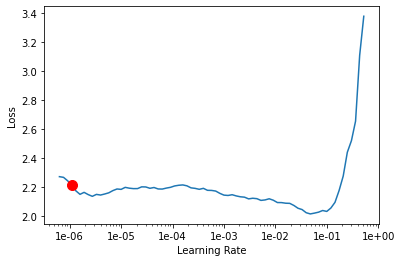

In [ ]:
learn.recorder.plot(suggestion=True)


In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.096478196143185e-06


In [ ]:
lr=1e-02
learn.fit_one_cycle(6,slice(lr,lr/5))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,2.128837,45.080578,0.684066,0.315934,01:55
1,2.050036,28.179152,0.631868,0.368132,01:59
2,1.855183,2.116893,0.695055,0.304945,01:59
3,1.690441,1.983004,0.695055,0.304945,01:56
4,1.591318,1.291639,0.582418,0.417582,01:55
5,1.545138,1.244680,0.618132,0.381868,01:56


In [ ]:
learn.save('stage-2-rn18') 

In [ ]:
data=get_data(128)

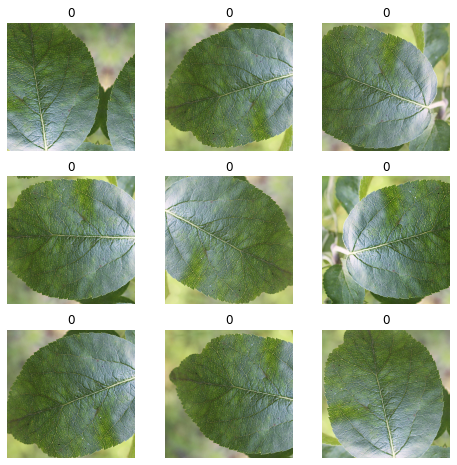

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

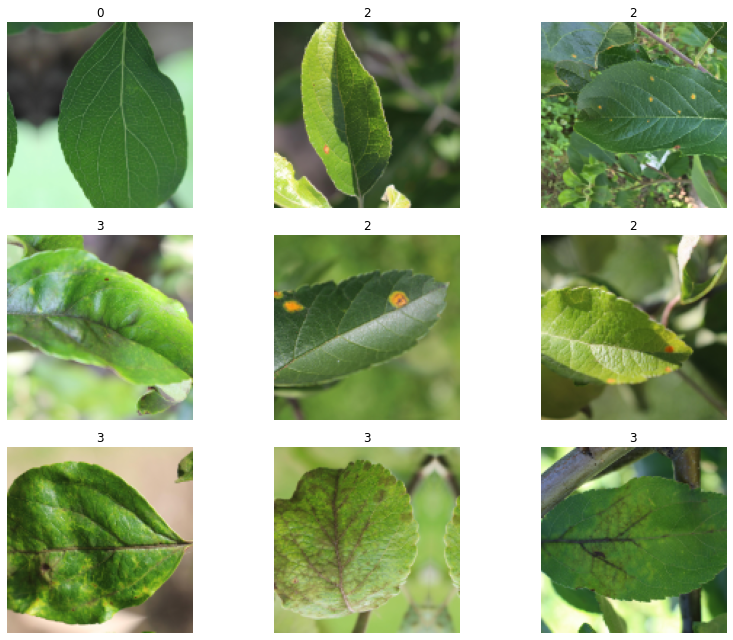

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.lr_find()


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.20E-05
Min loss divided by 10: 3.98E-03


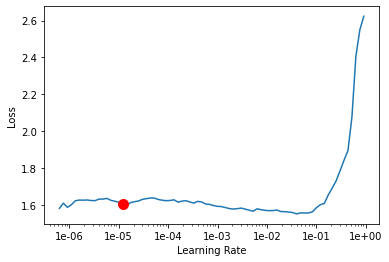

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.202264434617413e-05


In [ ]:
learn.fit_one_cycle(8, slice(mingradlr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.638575,1.270011,0.648352,0.351648,02:02
1,1.620553,1.272163,0.651099,0.348901,02:03
2,1.597682,1.252005,0.612637,0.387363,02:03
3,1.599187,1.245146,0.620879,0.379121,02:04
4,1.586151,1.240355,0.609890,0.390110,02:05
5,1.582689,1.240412,0.612637,0.387363,02:06
6,1.575434,1.240782,0.623626,0.376374,02:04
7,1.591855,1.237966,0.604396,0.395604,02:04


In [ ]:
learn.save('stage-3-rn18')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.91E-06
Min loss divided by 10: 4.79E-03


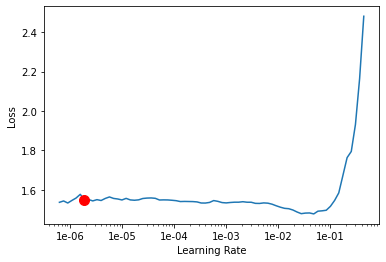

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.9054607179632473e-06


In [ ]:
lr=mingradlr
learn.fit_one_cycle(6,slice(lr,lr/5))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.505667,1.238439,0.607143,0.392857,02:04
1,1.526011,1.236528,0.615385,0.384615,02:06
2,1.536315,1.233545,0.607143,0.392857,02:04
3,1.541342,1.236669,0.609890,0.390110,02:05
4,1.548710,1.235101,0.604396,0.395604,02:04
5,1.555542,1.230862,0.598901,0.401099,02:08


In [ ]:
learn.save('stage-4-rn18') 

In [ ]:
data=get_data(512)

FileNotFoundError: ignored

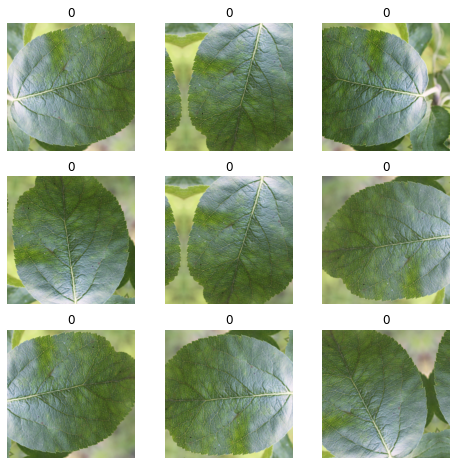

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

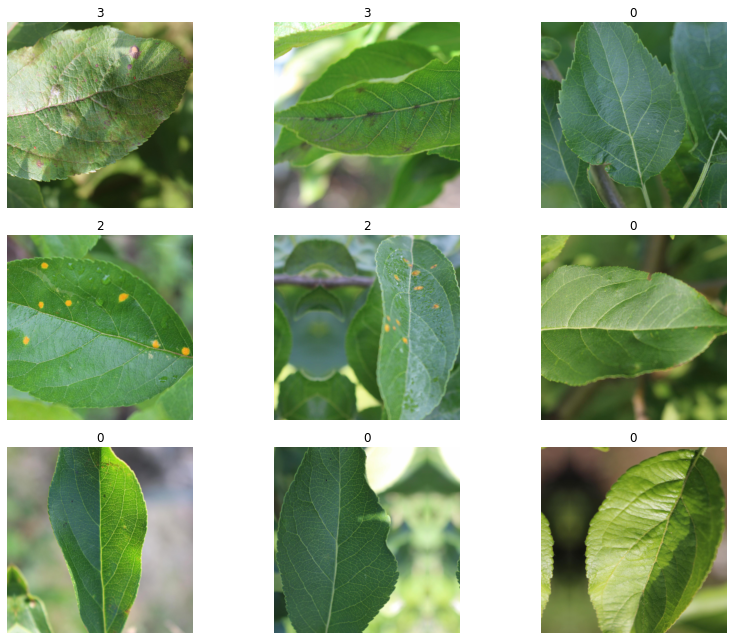

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.lr_find()


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 6.31E-03
Min loss divided by 10: 1.45E-02


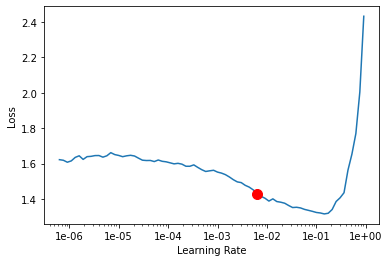

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

0.006309573444801929


In [ ]:
learn.fit_one_cycle(9, slice(mingradlr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.485937,1.499362,0.538462,0.461538,04:33
1,1.310991,0.938171,0.461538,0.538462,04:29
2,1.067334,0.603315,0.244505,0.755495,04:31
3,0.890484,0.731521,0.304945,0.695055,04:30
4,0.740763,0.415356,0.126374,0.873626,04:30
5,0.620891,0.370807,0.115385,0.884615,04:31
6,0.514644,0.344223,0.112637,0.887363,04:32
7,0.440405,0.268842,0.082418,0.917582,04:35
8,0.377006,0.261075,0.079670,0.920330,04:36


In [ ]:
learn.save('stage-4-rn18')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.58E-06
Min loss divided by 10: 9.12E-08


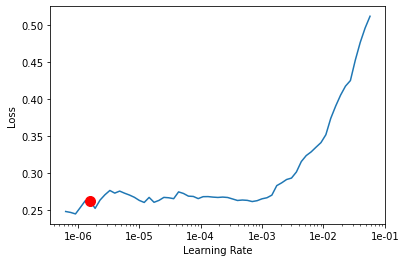

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.5848931924611132e-06


In [ ]:
lr=mingradlr
learn.fit_one_cycle(6,slice(lr,lr/5))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.286766,0.260714,0.076923,0.923077,04:36
1,0.267349,0.260025,0.076923,0.923077,04:36
2,0.264383,0.258585,0.076923,0.923077,04:37
3,0.266365,0.260809,0.076923,0.923077,04:36
4,0.262298,0.257992,0.079670,0.920330,04:36
5,0.275227,0.260327,0.076923,0.923077,04:36


In [ ]:
learn.save('stage-5-rn18')                 

In [ ]:
learn.load('stage-5-rn18')

Learner(data=ImageDataBunch;

Train: LabelList (1457 items)
x: ImageList
Image (3, 1024, 1024),Image (3, 1024, 1024),Image (3, 1024, 1024),Image (3, 1024, 1024),Image (3, 1024, 1024)
y: CategoryList
3,1,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Valid: LabelList (364 items)
x: ImageList
Image (3, 1024, 1024),Image (3, 1024, 1024),Image (3, 1024, 1024),Image (3, 1024, 1024),Image (3, 1024, 1024)
y: CategoryList
2,0,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05

In [ ]:
data=get_data(1024)

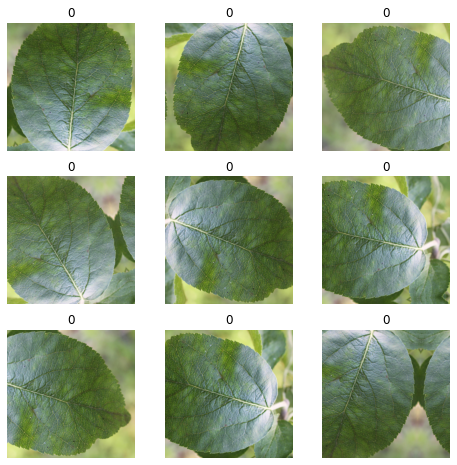

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

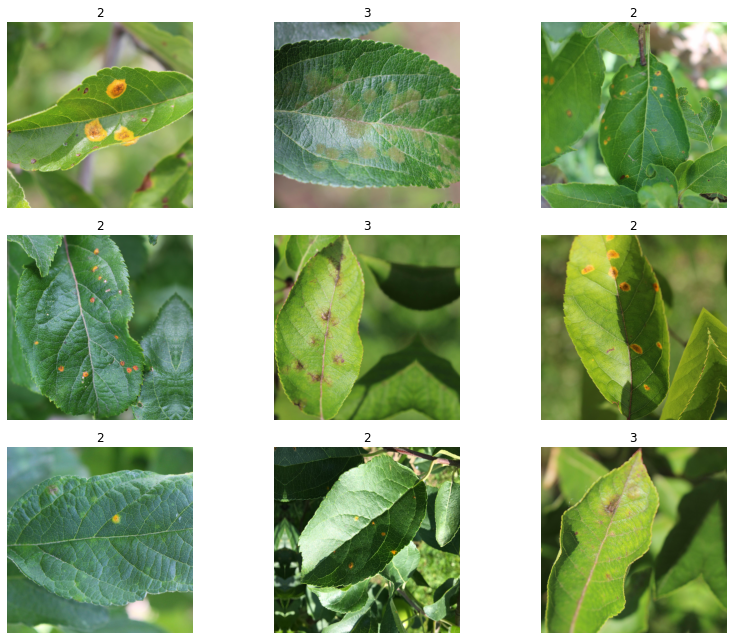

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.lr_find()


epoch,train_loss,valid_loss,error_rate,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 6.31E-07
Min loss divided by 10: 7.59E-08


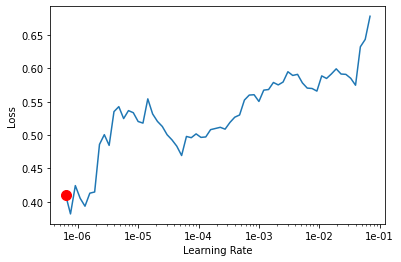

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

6.309573444801933e-07


In [ ]:
learn.fit_one_cycle(6, slice(mingradlr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.491468,0.476998,0.131868,0.868132,05:55
1,0.478023,0.431868,0.123626,0.876374,05:52
2,0.500092,0.414914,0.118132,0.881868,05:56
3,0.493145,0.474512,0.137363,0.862637,05:55
4,0.489598,0.423792,0.120879,0.879121,05:52
5,0.470160,0.402607,0.112637,0.887363,05:53


In [ ]:
learn.save('stage-6-rn18')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 9.12E-07
Min loss divided by 10: 1.10E-07


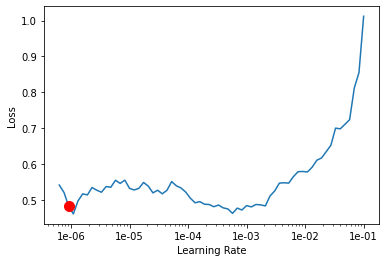

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

9.120108393559096e-07


In [ ]:
lr=1e-03
learn.fit_one_cycle(4,slice(lr,lr/20))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.505656,0.647775,0.241758,0.758242,05:57
1,0.511610,0.324629,0.090659,0.909341,05:55
2,0.414762,0.236451,0.079670,0.920330,05:56
3,0.336541,0.214987,0.074176,0.925824,05:56


In [ ]:
learn.save('stage-7-rn18') 

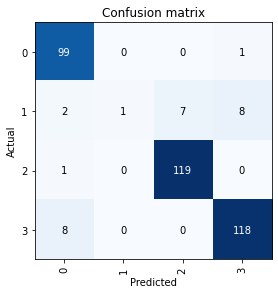

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')

In [ ]:
def prediction(learn,filename):
  testdf = pd.read_csv(path/"test.csv")
  sampsubmit = pd.read_csv(path/"sample_submission.csv")
  testdata= ImageList.from_folder(path/"images")
  testdf = pd.read_csv(path/"test.csv")
  sampsubmit = pd.read_csv(path/"sample_submission.csv")

  resultlist = []
  for item in testdata.items:
    img = open_image(item)
    predval = learn.predict(img)[2].tolist()
    predval.insert(0,item.name[:-4:])
    resultlist.append(predval)

  resultdf = pd.DataFrame(resultlist)
  resultdf.columns = sampsubmit.columns    
  resultdf.set_index("image_id",inplace=True)
  resultdf = resultdf.loc[sampsubmit.image_id,:]
  resultdf.to_csv(filename)



In [ ]:
def Submission_TTA(learn,filename):
  learn.export()
  testdata= ImageList.from_folder(path/"images")
  learn = load_learner(path, test=testdata)
  learn = learn.to_fp16()
  log_preds,y = learn.TTA(ds_type=DatasetType.Test)
  # log_preds,y = learn.TTA(ds_type=DatasetType.Test)
  testdf = pd.read_csv(path/"test.csv")
  sampsubmit = pd.read_csv(path/"sample_submission.csv")
  resultlist = []
  for item,result in zip(learn.data.test_ds.items,log_preds):
    predval =result.tolist()
    predval.insert(0,(str(item))[48:-4])
    resultlist.append(predval)
  resultdf = pd.DataFrame(resultlist)
  resultdf.columns = sampsubmit.columns    
  resultdf.set_index("image_id",inplace=True)
  resultdf = resultdf.loc[sampsubmit.image_id,:]
  resultdf.to_csv(filename)







In [ ]:
learn.export()

In [ ]:
prediction(learn,'helo.csv')

In [ ]:
testdata= ImageList.from_folder(path/"images")

In [ ]:
learn = load_learner(path, test=testdata)
learn = learn.to_fp16()
log_preds,y = learn.TTA(ds_type=DatasetType.Test)
# learner.TTA(ds_type=DatasetType.Test)

In [ ]:
log_preds[0][2].tolist()

0.0030558081343770027

In [ ]:
log_preds[0]

tensor([9.9618e-01, 3.8042e-04, 3.0558e-03, 3.8554e-04])

In [ ]:
learn.predict()

TypeError: ignored

In [ ]:
learn.predict(img).tolist()

AttributeError: ignored

In [ ]:
testdf = pd.read_csv(path/"test.csv")
testdf.head()

,image_id
0,Test_0
1,Test_1
2,Test_2
3,Test_3
4,Test_4


In [ ]:
sampsubmit = pd.read_csv(path/"sample_submission.csv")
sampsubmit.head()

,image_id,healthy,multiple_diseases,rust,scab
0,Test_0,0.25,0.25,0.25,0.25
1,Test_1,0.25,0.25,0.25,0.25
2,Test_2,0.25,0.25,0.25,0.25
3,Test_3,0.25,0.25,0.25,0.25
4,Test_4,0.25,0.25,0.25,0.25


In [ ]:
testdata= ImageList.from_folder(path/"images")

In [ ]:
testdata.filter_by_func(lambda x: x.name.startswith("Test"))

ImageList (1821 items)
Image (3, 1365, 2048),Image (3, 1365, 2048),Image (3, 1365, 2048),Image (3, 1365, 2048),Image (3, 1365, 2048)
Path: /content/plant-pathology-2020-fgvc7/data/images

In [ ]:
testdata.items[0]

PosixPath('/content/plant-pathology-2020-fgvc7/data/images/Test_873.jpg')

In [ ]:
img1 = open_image(testdata.items[0])
img2 = open_image(testdata.items[1])

In [ ]:
learn.predict(img1)

(Category tensor(3),
 tensor(3),
 tensor([2.3371e-03, 1.6252e-03, 1.7063e-04, 9.9587e-01]))

In [ ]:
val1 = learn.predict(img1)[2].tolist()

In [ ]:
tdtd = testdata.items[0]

In [ ]:
tdtd.name[:-4:]

'Test_873'

In [ ]:
resultlist = []
for item in testdata.items:
    img = open_image(item)
    predval = learn.predict(img)[2].tolist()
    predval.insert(0,item.name[:-4:])
    resultlist.append(predval)

KeyboardInterrupt: ignored

In [ ]:
resultlist = []
for item,result in zip(learn.data.test_ds.items,log_preds):
    predval =result.tolist()
    predval.insert(0,(str(item))[48:-4])
    resultlist.append(predval)

In [ ]:
fnames = [(str(f))[48:-4] for f in learn.data.test_ds.items] 

ds = pd.DataFrame({'image_id':fnames  } ,columns=sampsubmit.columns)
ds

,image_id,healthy,multiple_diseases,rust,scab
0,Train_1774,NaN,NaN,NaN,NaN
1,Test_873,NaN,NaN,NaN,NaN
2,Test_446,NaN,NaN,NaN,NaN
3,Test_662,NaN,NaN,NaN,NaN
4,Test_1768,NaN,NaN,NaN,NaN
...,...,...,...,...,...
3637,Test_1580,NaN,NaN,NaN,NaN
3638,Test_455,NaN,NaN,NaN,NaN
3639,Test_521,NaN,NaN,NaN,NaN
3640,Test_97,NaN,NaN,NaN,NaN


In [ ]:
resultlist[0:5]

[['Train_1774',
  0.9873741269111633,
  0.0013965028338134289,
  0.009655294008553028,
  0.0015740595990791917],
 ['Test_873',
  0.0022677029483020306,
  0.0021715557668358088,
  0.00016078577027656138,
  0.9954000115394592],
 ['Test_446',
  7.881481724325567e-05,
  0.0013471737038344145,
  0.9976106882095337,
  0.0009634186280891299],
 ['Test_662',
  0.00015485296898987144,
  0.00022697111126035452,
  0.0006298132939264178,
  0.9989883899688721],
 ['Test_1768',
  0.0643305778503418,
  0.01979411579668522,
  0.9123528003692627,
  0.0035225609317421913]]

In [ ]:
resultdf = pd.DataFrame(resultlist)
resultdf.columns = sampsubmit.columns
resultdf.head()

,image_id,healthy,multiple_diseases,rust,scab
0,Train_1774,0.987374,0.001397,0.009655,0.001574
1,Test_873,0.002268,0.002172,0.000161,0.995400
2,Test_446,0.000079,0.001347,0.997611,0.000963
3,Test_662,0.000155,0.000227,0.000630,0.998988
4,Test_1768,0.064331,0.019794,0.912353,0.003523


In [ ]:
resultdf.set_index("image_id",inplace=True)
resultdf.head()

,healthy,multiple_diseases,rust,scab
image_id,,,,
Train_1774,0.987374,0.001397,0.009655,0.001574
Test_873,0.002268,0.002172,0.000161,0.995400
Test_446,0.000079,0.001347,0.997611,0.000963
Test_662,0.000155,0.000227,0.000630,0.998988
Test_1768,0.064331,0.019794,0.912353,0.003523


In [ ]:


resultdf = resultdf.loc[sampsubmit.image_id,:]
resultdf.tail()



,healthy,multiple_diseases,rust,scab
image_id,,,,
Test_1816,0.000106,0.048227,0.951299,0.000369
Test_1817,0.000143,0.035983,0.001003,0.962870
Test_1818,0.000375,0.022958,0.976187,0.000480
Test_1819,0.994096,0.000527,0.000902,0.004475
Test_1820,0.036787,0.094536,0.000445,0.868232


In [ ]:
resultdf.head()

,healthy,multiple_diseases,rust,scab
image_id,,,,
Test_0,8.188955e-03,0.065298,0.923396,0.003118
Test_1,1.592344e-04,0.013578,0.982655,0.003608
Test_2,1.188613e-03,0.000259,0.000023,0.998530
Test_3,9.991854e-01,0.000020,0.000131,0.000663
Test_4,1.139681e-07,0.000388,0.999610,0.000001


In [ ]:
resultdf.to_csv("submit12.csv")

# **RESNET34**

In [ ]:
def get_data(sz,bs=64):
  data =  src.transform(tfms, size=sz).databunch(bs=bs).normalize(imagenet_stats)
  return data


In [ ]:
# data = (src.transform(tfms, size=32)
#         .databunch().normalize(imagenet_stats))
data=get_data(28)
# /content/plant-pathology-2020-fgvc7/Test_0.jpg

You can deactivate this warning by passing `no_check=True`.


/usr/local/lib/python3.6/dist-packages/fastai/basic_data.py:262: UserWarning: There seems to be something wrong with your dataset, for example, in the first batch can't access these elements in self.train_ds: 609,411
  warn(warn_msg)


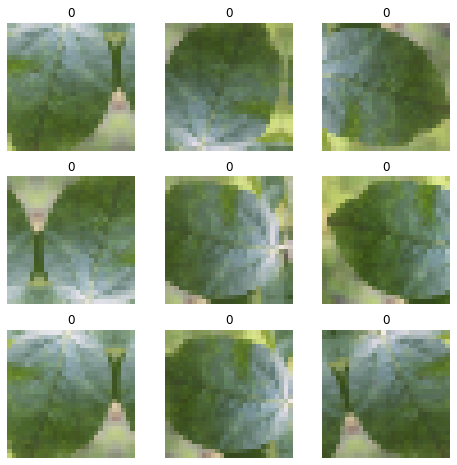

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

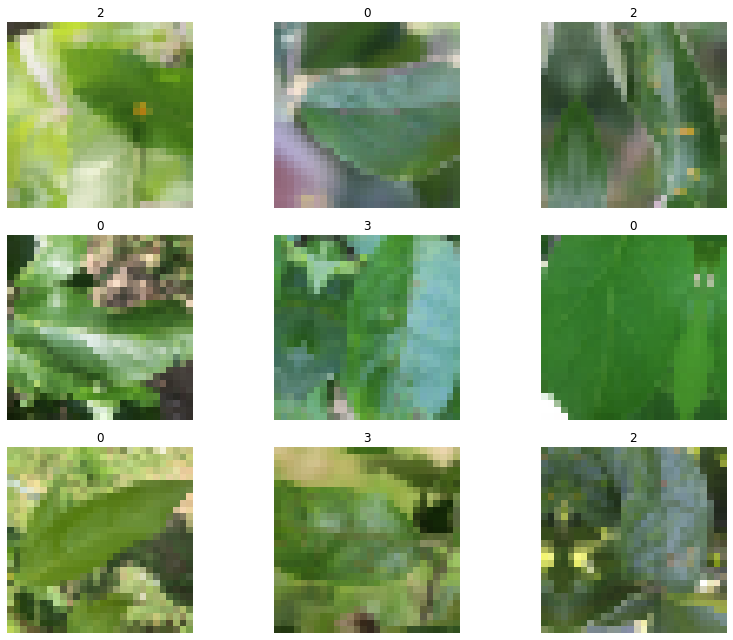

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
data.classes

[0, 1, 2, 3]

In [ ]:
arch = models.resnet34

In [ ]:
learn = cnn_learner(data, arch, metrics=[error_rate, accuracy]).mixup()

In [ ]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


Min numerical gradient: 6.31E-05
Min loss divided by 10: 6.92E-03


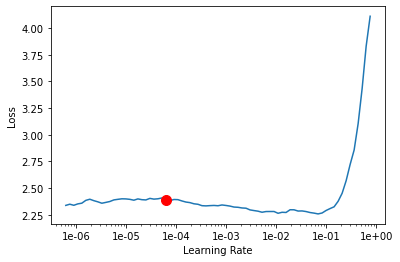

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

6.309573444801929e-05


In [ ]:
learn.fit_one_cycle(7, slice(mingradlr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,2.399940,1.607129,0.774725,0.225275,01:58
1,2.371052,1.744968,0.771978,0.228022,01:55
2,2.332330,1.780494,0.728022,0.271978,01:56
3,2.295743,1.750151,0.747253,0.252747,01:56
4,2.277269,1.735135,0.733516,0.266484,01:56
5,2.263992,1.733417,0.752747,0.247253,01:56
6,2.254771,1.704547,0.725275,0.274725,01:55


In [ ]:
learn.save('stage-1-rn51')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.10E-06
Min loss divided by 10: 4.79E-03


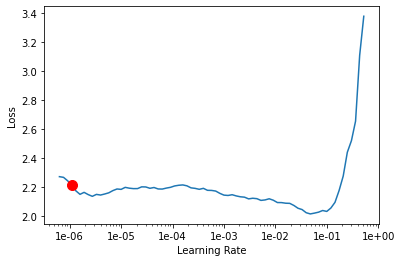

In [ ]:
learn.recorder.plot(suggestion=True)


In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.096478196143185e-06


In [ ]:
lr=1e-02
learn.fit_one_cycle(6,slice(lr,lr/5))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,2.128837,45.080578,0.684066,0.315934,01:55
1,2.050036,28.179152,0.631868,0.368132,01:59
2,1.855183,2.116893,0.695055,0.304945,01:59
3,1.690441,1.983004,0.695055,0.304945,01:56
4,1.591318,1.291639,0.582418,0.417582,01:55
5,1.545138,1.244680,0.618132,0.381868,01:56


In [ ]:
learn.save('stage-2-rn18') 

In [ ]:
learn.freeze()

In [ ]:
data=get_data(128)

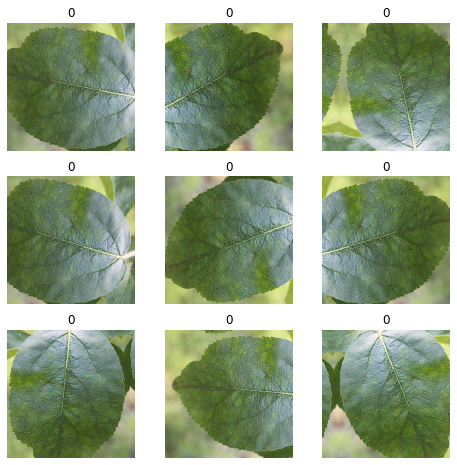

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

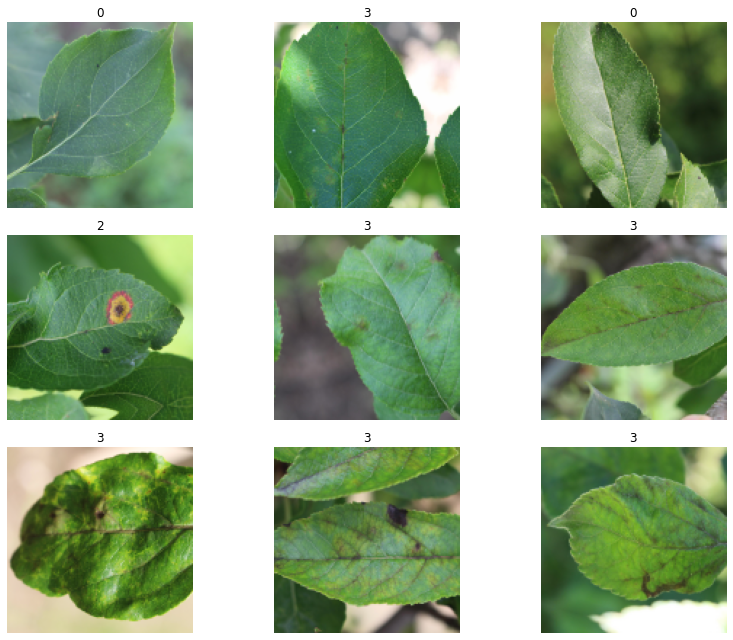

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.lr_find()


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.45E-03
Min loss divided by 10: 1.45E-02


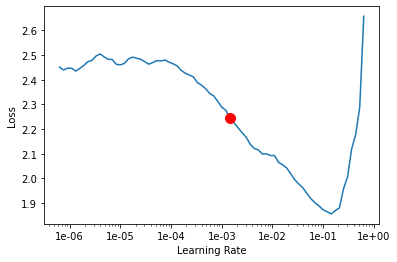

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

0.001445439770745928


In [ ]:
learn.fit_one_cycle(10, slice(1e-02))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.778925,0.802362,0.241758,0.758242,02:09
1,1.542176,0.700564,0.233516,0.766484,02:10
2,1.334984,0.620939,0.197802,0.802198,02:10
3,1.190964,0.493792,0.167582,0.832418,02:11
4,1.073552,0.444545,0.156593,0.843407,02:11
5,1.000572,0.431080,0.142857,0.857143,02:12
6,0.925955,0.405538,0.131868,0.868132,02:10
7,0.852573,0.399125,0.134615,0.865385,02:09
8,0.807838,0.383851,0.126374,0.873626,02:11
9,0.782925,0.377555,0.120879,0.879121,02:12


In [ ]:
learn.save('stage-3-rn34')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.10E-06
Min loss divided by 10: 5.75E-05


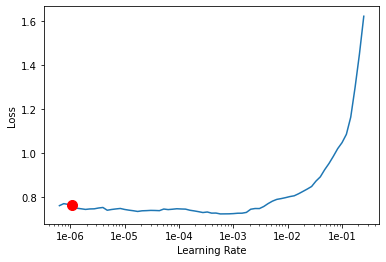

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.096478196143185e-06


In [ ]:
lr=1e-04
learn.fit_one_cycle(6,slice(lr,lr/20))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.718885,0.371700,0.123626,0.876374,02:12
1,0.699038,0.332111,0.118132,0.881868,02:12
2,0.684551,0.311907,0.112637,0.887363,02:11
3,0.670632,0.307055,0.107143,0.892857,02:10
4,0.650953,0.302880,0.101648,0.898352,02:11
5,0.649320,0.296340,0.101648,0.898352,02:12


In [ ]:
learn.save('stage-4-rn34') 

In [ ]:
learn.freeze()

In [ ]:
data=get_data(224)

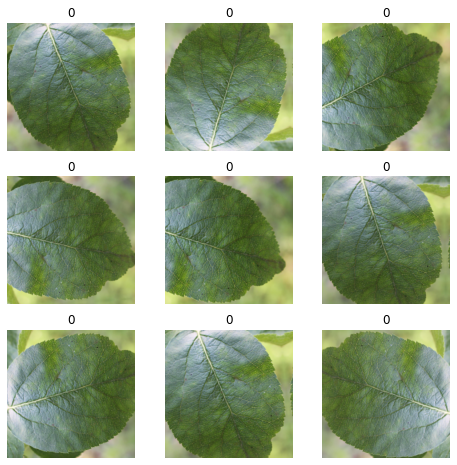

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

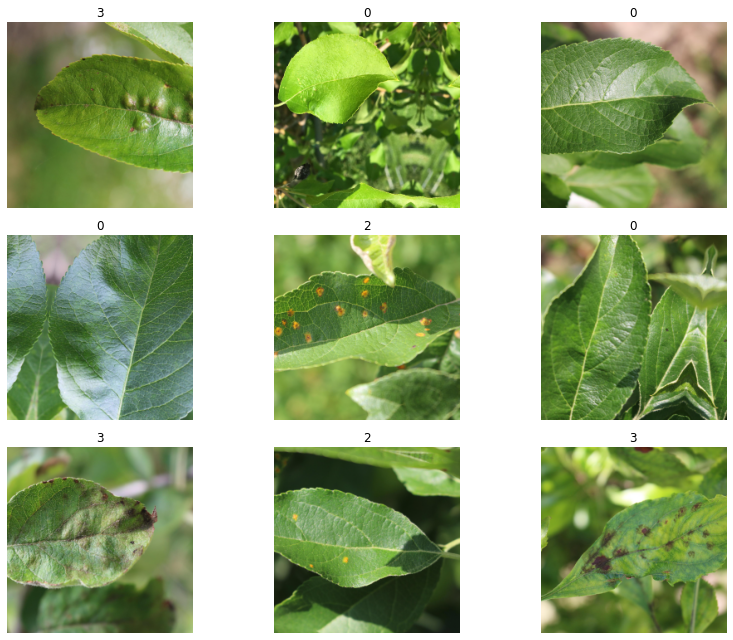

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
data.classes

[0, 1, 2, 3]

In [ ]:
arch = models.resnet34

In [ ]:
learn = cnn_learner(data, arch, metrics=[error_rate, accuracy]).mixup()

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/checkpoints/resnet34-333f7ec4.pth


In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 3.02E-03
Min loss divided by 10: 1.45E-02


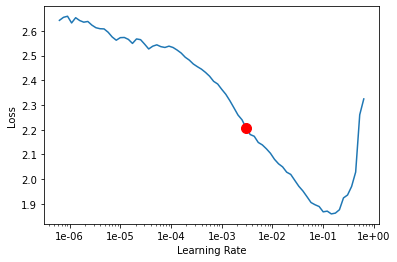

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

0.0030199517204020187


In [ ]:
lr=1e-02
learn.fit_one_cycle(10, slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.670130,0.627174,0.206044,0.793956,02:10
1,1.436554,0.532619,0.167582,0.832418,02:12
2,1.228162,0.442043,0.123626,0.876374,02:14
3,1.069460,0.318138,0.101648,0.898352,02:10
4,0.948154,0.358204,0.123626,0.876374,02:07
5,0.860029,0.318526,0.115385,0.884615,02:06
6,0.797617,0.280441,0.104396,0.895604,02:06
7,0.740334,0.284729,0.093407,0.906593,02:07
8,0.700316,0.270898,0.090659,0.909341,02:12
9,0.675132,0.271661,0.085165,0.914835,02:13


In [ ]:
learn.save('stage-5-rn34')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.10E-06
Min loss divided by 10: 1.00E-04


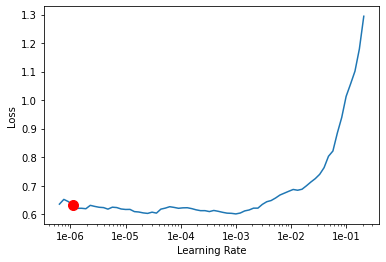

In [ ]:
learn.recorder.plot(suggestion=True)


In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.096478196143185e-06


In [ ]:
lr=1e-04
learn.fit_one_cycle(6,slice(lr,lr/20))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.636714,0.262453,0.085165,0.914835,02:04
1,0.599563,0.238605,0.065934,0.934066,02:04
2,0.574867,0.214509,0.057692,0.942308,02:03
3,0.569170,0.212019,0.043956,0.956044,02:04
4,0.561592,0.201240,0.049451,0.950549,02:03
5,0.557024,0.205598,0.052198,0.947802,02:07


In [ ]:
learn.save('stage-6-rn34') 

In [ ]:
learn.freeze()

In [ ]:
data=get_data(512)

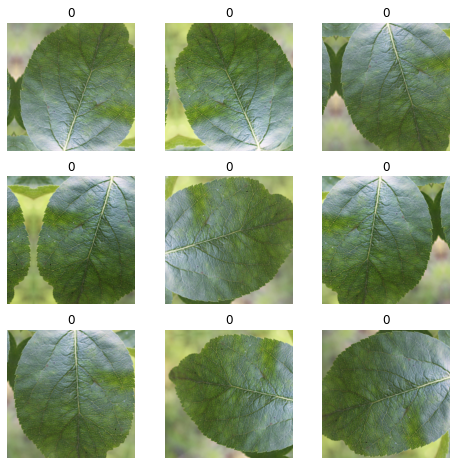

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

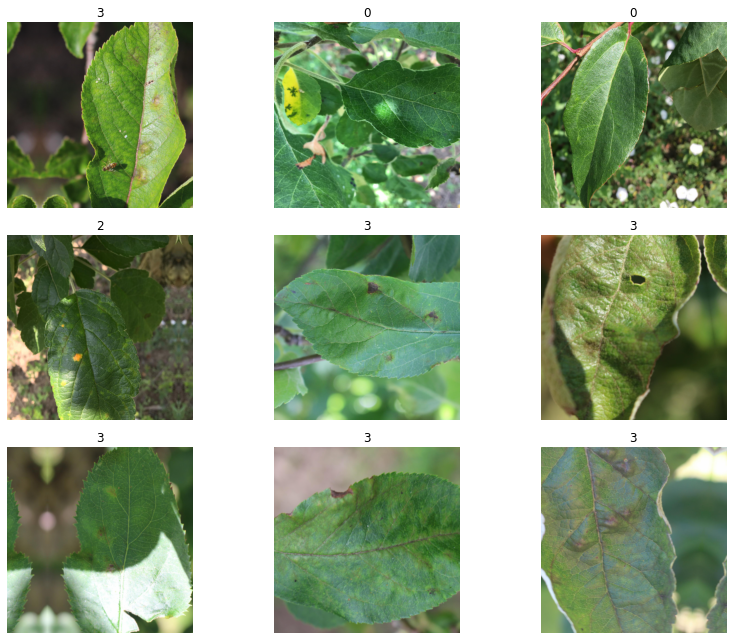

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


Min numerical gradient: 1.32E-06
Min loss divided by 10: 1.10E-03


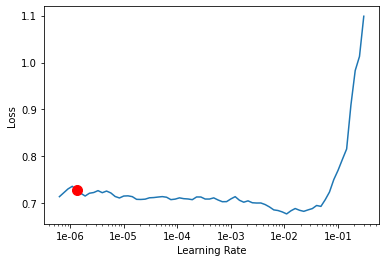

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.3182567385564074e-06


In [ ]:
lr=2e-03
learn.fit_one_cycle(9, slice(2e-03))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.703322,0.307990,0.104396,0.895604,04:06
1,0.667907,0.273413,0.082418,0.917582,04:12
2,0.641347,0.248233,0.082418,0.917582,04:14
3,0.615362,0.232965,0.065934,0.934066,04:23
4,0.594315,0.213626,0.063187,0.936813,04:24
5,0.572835,0.208701,0.060440,0.939560,04:20
6,0.569473,0.204272,0.049451,0.950549,04:12
7,0.554822,0.209544,0.054945,0.945055,04:04
8,0.543878,0.209583,0.057692,0.942308,04:02


In [ ]:
learn.save('stage-7-rn34')                   

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 6.31E-07
Min loss divided by 10: 7.59E-08


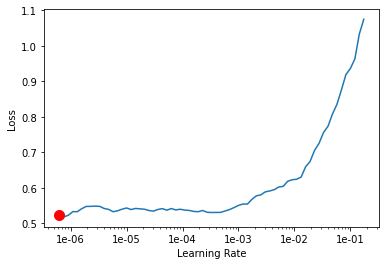

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

6.309573444801933e-07


In [ ]:
lr=1e-04
learn.fit_one_cycle(6,slice(lr,lr/20))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.567279,0.205855,0.057692,0.942308,04:00
1,0.544181,0.190228,0.057692,0.942308,03:57
2,0.520362,0.212010,0.060440,0.939560,03:56
3,0.509327,0.171641,0.052198,0.947802,03:58
4,0.500819,0.165212,0.052198,0.947802,04:00
5,0.494718,0.168390,0.052198,0.947802,03:58


In [ ]:
learn.save('stage-8-rn34')                 

In [ ]:
learn.load('stage-5-rn18')

In [ ]:
data=get_data(1024)

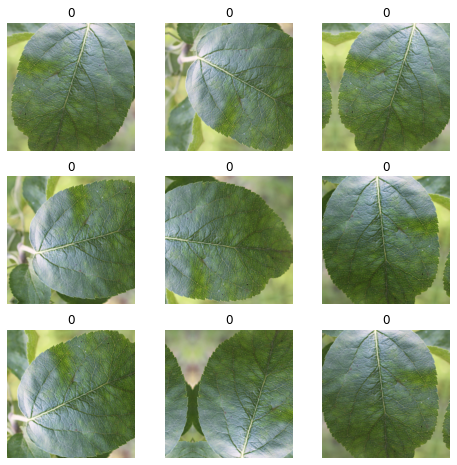

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

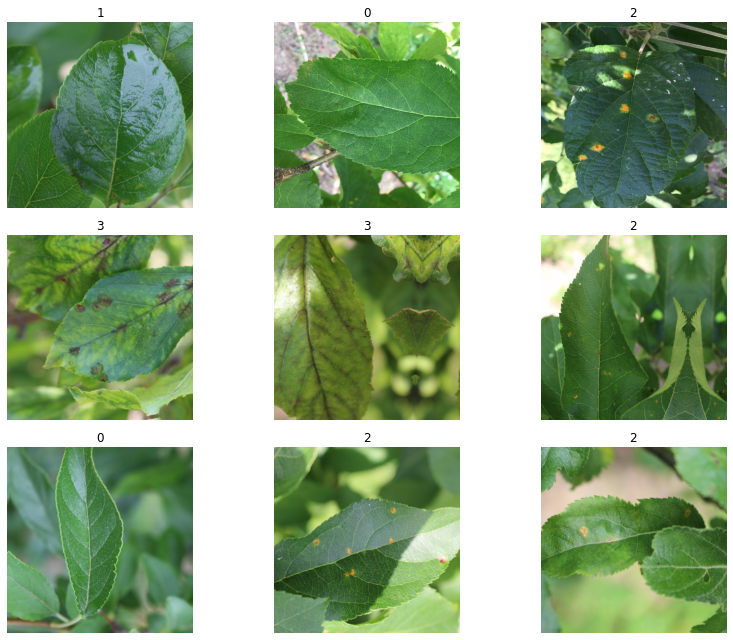

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.lr_find()


epoch,train_loss,valid_loss,error_rate,accuracy,time


RuntimeError: ignored

Min numerical gradient: 6.31E-07
Min loss divided by 10: 7.59E-08


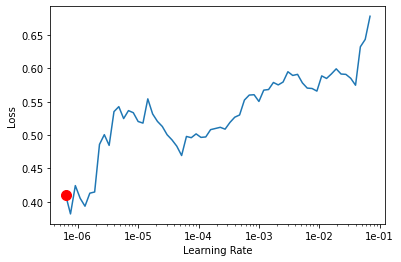

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

6.309573444801933e-07


In [ ]:
learn.fit_one_cycle(6, slice(mingradlr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.491468,0.476998,0.131868,0.868132,05:55
1,0.478023,0.431868,0.123626,0.876374,05:52
2,0.500092,0.414914,0.118132,0.881868,05:56
3,0.493145,0.474512,0.137363,0.862637,05:55
4,0.489598,0.423792,0.120879,0.879121,05:52
5,0.470160,0.402607,0.112637,0.887363,05:53


In [ ]:
learn.save('stage-9-rn34')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 9.12E-07
Min loss divided by 10: 1.10E-07


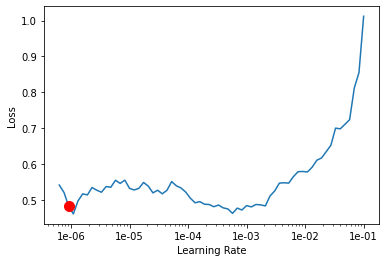

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

9.120108393559096e-07


In [ ]:
lr=1e-03
learn.fit_one_cycle(4,slice(lr,lr/20))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.505656,0.647775,0.241758,0.758242,05:57
1,0.511610,0.324629,0.090659,0.909341,05:55
2,0.414762,0.236451,0.079670,0.920330,05:56
3,0.336541,0.214987,0.074176,0.925824,05:56


In [ ]:
learn.save('stage-10-rn34') 

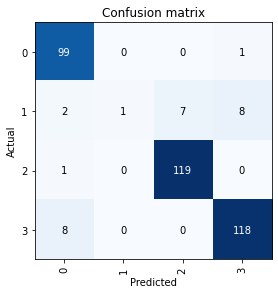

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')

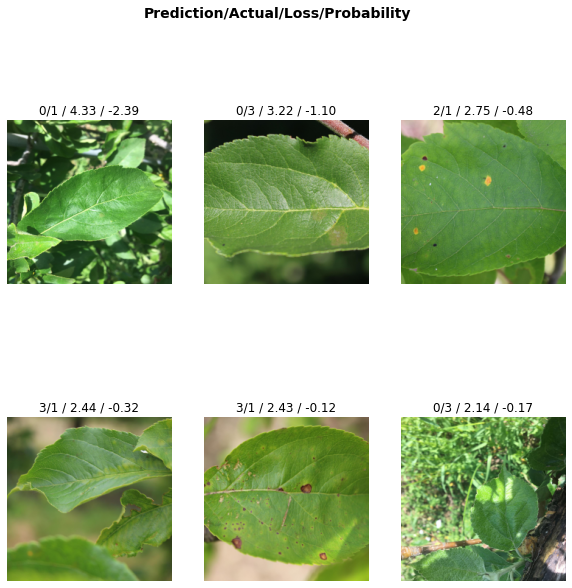

In [ ]:
interp.plot_top_losses(6, figsize=(10,10))

In [ ]:
Submission_TTA(learn,'submit10.csv')

RuntimeError: ignored

# RESNET51

In [ ]:

data=get_data(128)

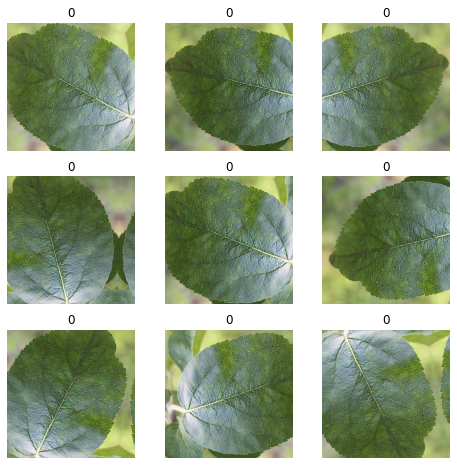

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

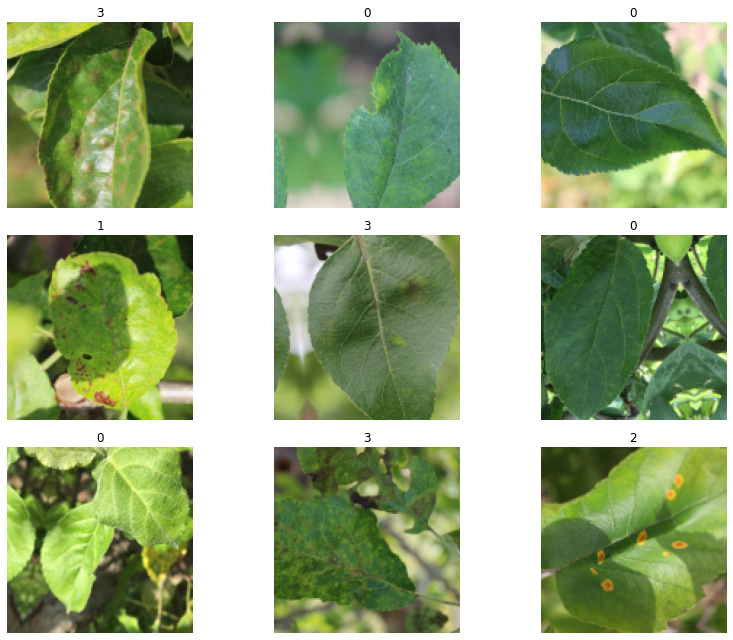

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
data.classes

[0, 1, 2, 3]

In [ ]:
arch = models.resnet50

In [ ]:
learn = cnn_learner(data, arch, metrics=[error_rate, accuracy]).to_fp16()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 3.31E-04
Min loss divided by 10: 1.45E-02


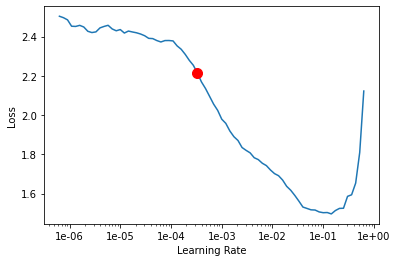

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

0.0003311311214825911


In [ ]:
lr=1e-02
learn.fit_one_cycle(10, slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.388932,0.990060,0.214286,0.785714,02:13
1,1.142363,0.596401,0.159341,0.840659,02:11
2,0.889587,0.557117,0.164835,0.835165,02:10
3,0.733593,0.473747,0.151099,0.848901,02:12
4,0.632084,0.422536,0.129121,0.870879,02:11
5,0.553839,0.391901,0.142857,0.857143,02:13
6,0.464802,0.377248,0.123626,0.876374,02:10
7,0.410003,0.348908,0.109890,0.890110,02:11
8,0.355381,0.357024,0.123626,0.876374,02:13
9,0.326217,0.344912,0.118132,0.881868,02:13


In [ ]:
learn.save('stage-1-rn51')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 2.29E-06
Min loss divided by 10: 6.31E-08


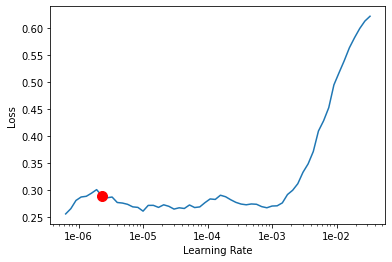

In [ ]:
learn.recorder.plot(suggestion=True)


In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

2.2908676527677735e-06


In [ ]:
lr=3e-04
learn.fit_one_cycle(6,slice(lr,lr/20,lr/200))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.252820,0.298583,0.090659,0.909341,02:14
1,0.242841,0.343385,0.109890,0.890110,02:14
2,0.237502,0.266850,0.098901,0.901099,02:14
3,0.212857,0.224528,0.079670,0.920330,02:15
4,0.182684,0.221764,0.085165,0.914835,02:13
5,0.165410,0.212494,0.076923,0.923077,02:14


In [ ]:
learn.save('stage-2-rn51') 

In [ ]:
learn.freeze()

In [ ]:
data=get_data(224)

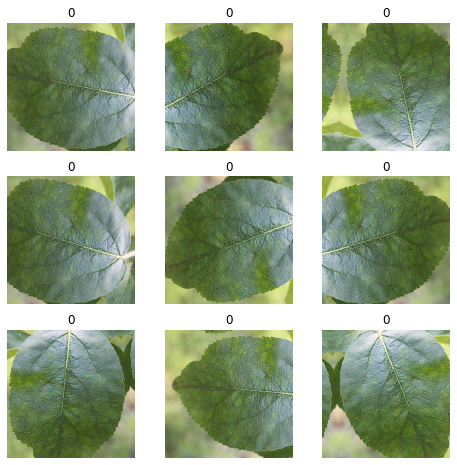

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

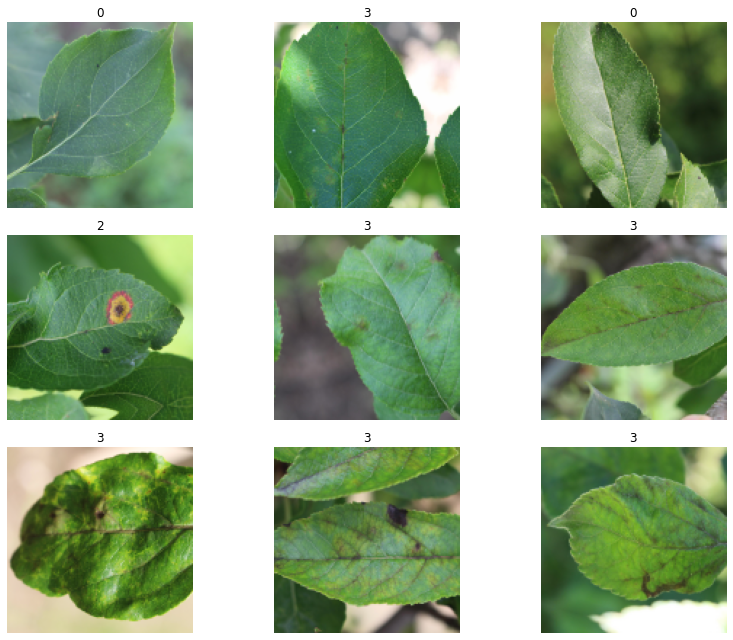

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.lr_find()


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 9.12E-07
Min loss divided by 10: 7.59E-04


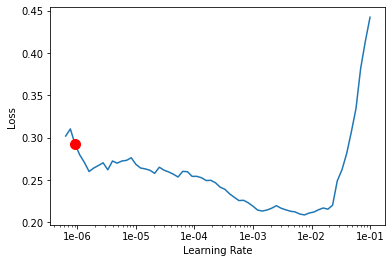

In [ ]:

learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

9.120108393559096e-07


In [ ]:
lr=1e-03
learn.fit_one_cycle(10, slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.275717,0.258803,0.085165,0.914835,02:35
1,0.235958,0.252556,0.074176,0.925824,02:32
2,0.217901,0.227328,0.065934,0.934066,02:32
3,0.197413,0.220206,0.054945,0.945055,02:37
4,0.178053,0.217517,0.065934,0.934066,02:35
5,0.162997,0.210519,0.063187,0.936813,02:37
6,0.156771,0.211785,0.063187,0.936813,02:39
7,0.149241,0.206653,0.052198,0.947802,02:36
8,0.133271,0.205035,0.049451,0.950549,02:36
9,0.133088,0.205156,0.049451,0.950549,02:36


In [ ]:
learn.save('stage-3-rn51')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 9.12E-07
Min loss divided by 10: 3.63E-06


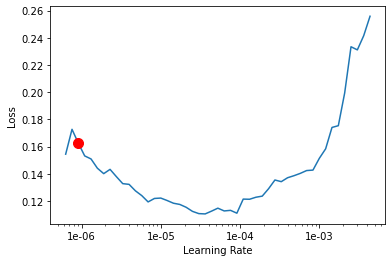

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

9.120108393559096e-07


In [ ]:
lr=1e-05
learn.fit_one_cycle(5,slice(lr,lr/20,lr/200))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.106317,0.200910,0.052198,0.947802,02:38
1,0.113208,0.200444,0.054945,0.945055,02:38
2,0.119985,0.201091,0.046703,0.953297,02:36
3,0.113400,0.201611,0.043956,0.956044,02:36
4,0.111557,0.201408,0.054945,0.945055,02:40


In [ ]:
learn.save('stage-4-rn51') 

In [ ]:
learn.load('stage-4-rn51') 

Learner(data=ImageDataBunch;

Train: LabelList (1457 items)
x: ImageList
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
y: CategoryList
3,1,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Valid: LabelList (364 items)
x: ImageList
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
y: CategoryList
2,0,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_r

In [ ]:
learn.freeze()

In [ ]:
data=get_data(512,16)

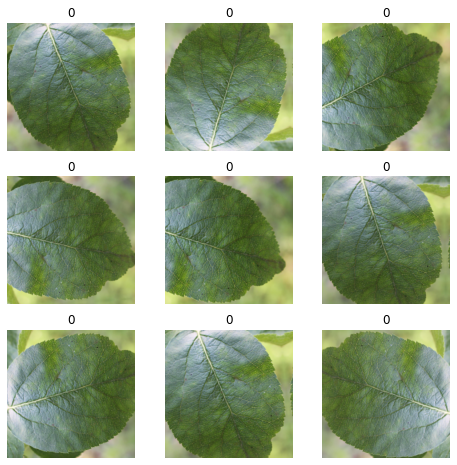

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

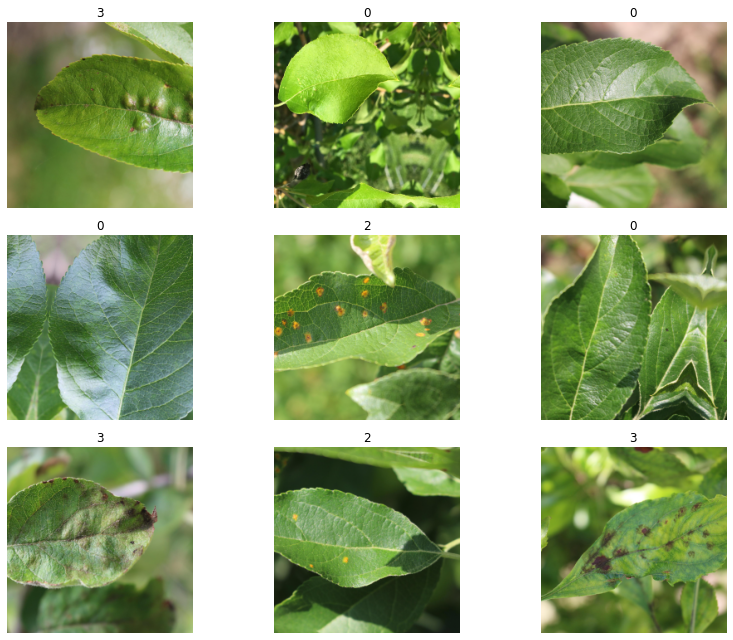

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 7.59E-07
Min loss divided by 10: 1.32E-03


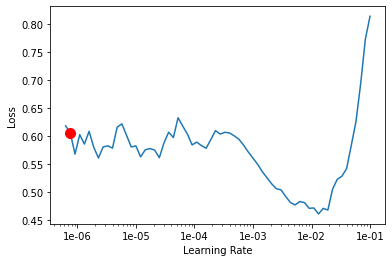

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

7.585775750291837e-07


In [ ]:
lr=3e-03
learn.fit_one_cycle(8,slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.454994,0.282450,0.101648,0.898352,05:14
1,0.371840,0.313865,0.079670,0.920330,05:08
2,0.414455,0.222591,0.063187,0.936813,05:07
3,0.293537,0.182007,0.054945,0.945055,05:08
4,0.254105,0.227377,0.060440,0.939560,05:06
5,0.245679,0.192814,0.054945,0.945055,05:05
6,0.194340,0.183760,0.054945,0.945055,05:11
7,0.164257,0.164516,0.038462,0.961538,05:09


In [ ]:
learn.save('stage-5-rn51')

In [ ]:
learn.load('stage-5-rn51')

Learner(data=ImageDataBunch;

Train: LabelList (1457 items)
x: ImageList
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
y: CategoryList
3,1,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Valid: LabelList (364 items)
x: ImageList
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
y: CategoryList
2,0,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_r

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.10E-06
Min loss divided by 10: 1.00E-06


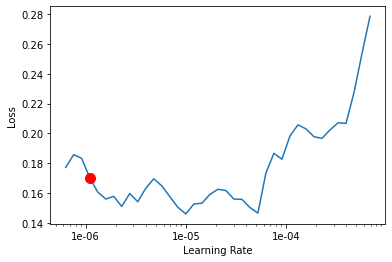

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.096478196143185e-06


In [ ]:
lr=mingradlr
learn.fit_one_cycle(5,slice(lr,lr/20,lr/200))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.179438,0.161912,0.038462,0.961538,05:14
1,0.161506,0.169886,0.041209,0.958791,05:16
2,0.145025,0.173873,0.043956,0.956044,05:21
3,0.156066,0.176562,0.046703,0.953297,05:20
4,0.138594,0.163865,0.043956,0.956044,05:21


In [ ]:
learn.save('stage-6-rn51')

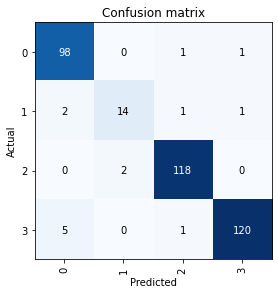

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')

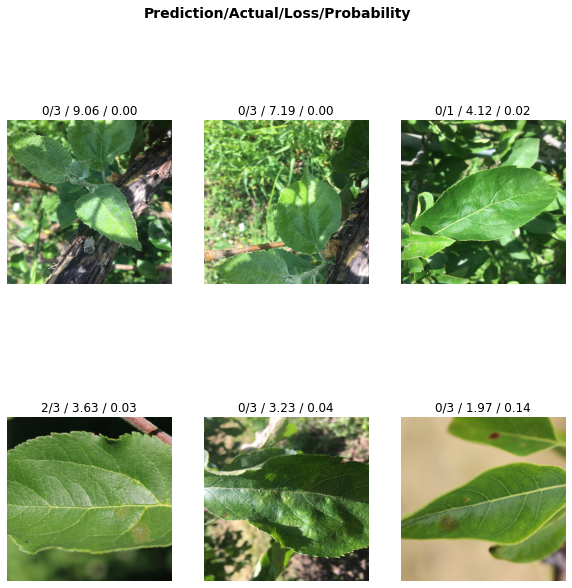

In [ ]:
interp.plot_top_losses(6, figsize=(10,10))

In [ ]:
Submission_TTA(learn,'submit12.csv')

In [ ]:
learn = learn.to_fp16()





```
# This is formatted as code
```

# RESNET156

In [ ]:

data=get_data(512,16)

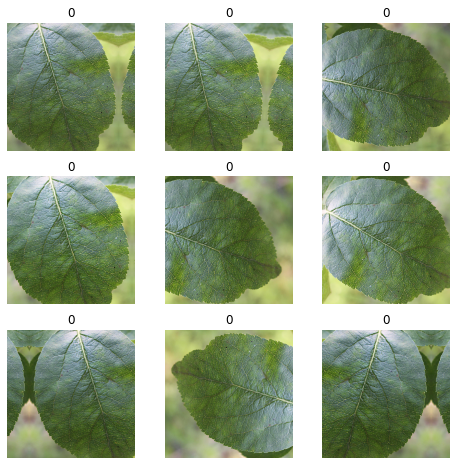

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

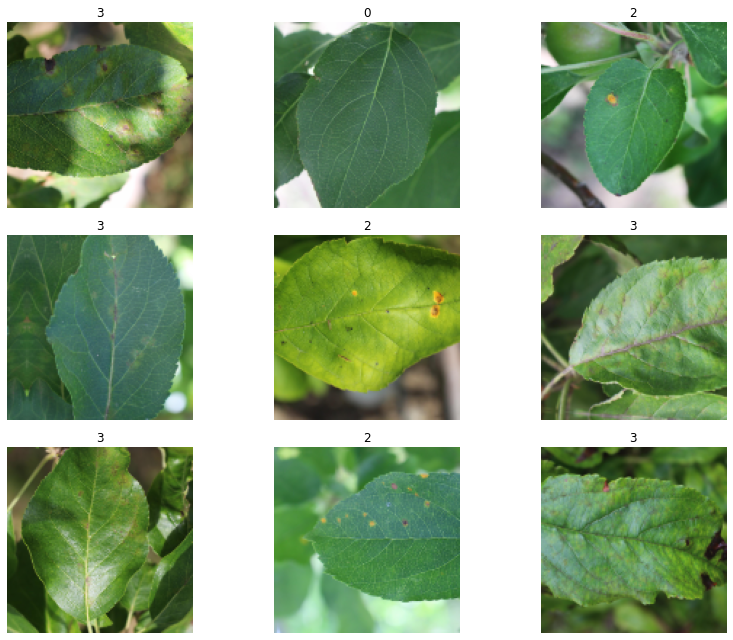

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
data.classes

[0, 1, 2, 3]

In [ ]:
arch = models.resnet152


In [ ]:
learn = cnn_learner(data, arch, metrics=[error_rate, accuracy]).to_fp16()

In [ ]:
learn.loss_func=LabelSmoothingCrossEntropy()

In [ ]:
learn.loss_func=LabelSmoothingCrossEntropy()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 3.98E-04
Min loss divided by 10: 1.20E-02


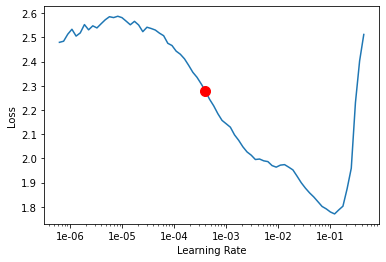

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

0.0003981071705534973


In [ ]:
lr=2e-02
learn.fit_one_cycle(10, slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.716133,1.784117,0.293956,0.706044,02:16
1,1.320883,0.819738,0.195055,0.804945,02:13
2,1.105157,0.796497,0.131868,0.868132,02:12
3,0.998640,0.840920,0.167582,0.832418,02:13
4,0.899917,0.667480,0.126374,0.873626,02:18
5,0.811229,0.578591,0.090659,0.909341,02:19
6,0.732652,0.558191,0.093407,0.906593,02:15
7,0.671461,0.540622,0.079670,0.920330,02:14
8,0.620391,0.531859,0.074176,0.925824,02:16
9,0.587110,0.528169,0.068681,0.931319,02:19


In [ ]:
learn.save('stage-1-rn51')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 3.31E-04
Min loss divided by 10: 3.98E-05


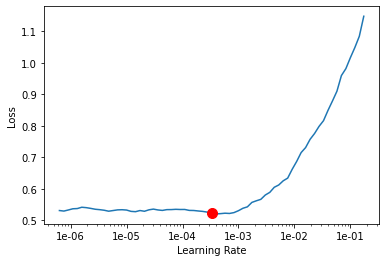

In [ ]:
learn.recorder.plot(suggestion=True)


In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

0.0003311311214825911


In [ ]:
lr=mingradlr
learn.fit_one_cycle(6,slice(lr,lr/20,lr/200))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.532512,0.511123,0.068681,0.931319,02:22
1,0.533413,0.682719,0.101648,0.898352,02:21
2,0.526151,0.510398,0.063187,0.936813,02:19
3,0.517241,0.464048,0.046703,0.953297,02:18
4,0.502779,0.464653,0.052198,0.947802,02:16
5,0.485613,0.459550,0.043956,0.956044,02:16


In [ ]:
learn.save('stage-2-rn152') 

In [ ]:
learn.freeze()

In [ ]:
data=get_data(224)

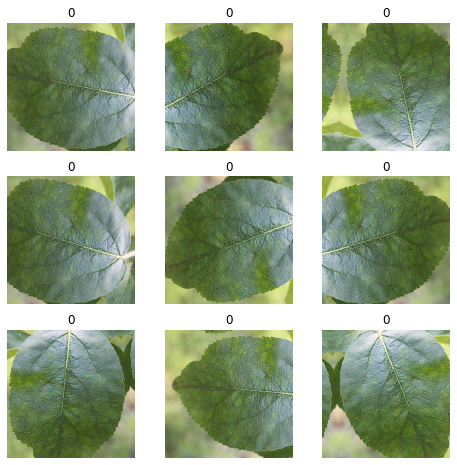

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

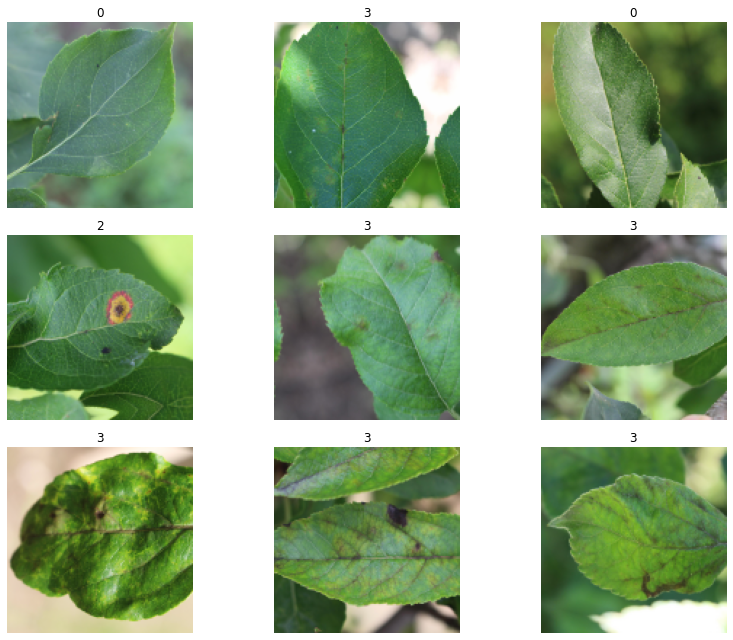

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.lr_find()


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 6.31E-07
Min loss divided by 10: 7.59E-08


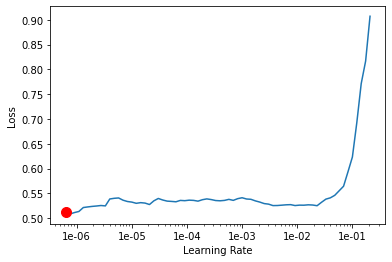

In [ ]:

learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

6.309573444801933e-07


In [ ]:
lr=1e-03
learn.fit_one_cycle(10, slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.525628,0.494186,0.063187,0.936813,02:47
1,0.525388,0.482094,0.049451,0.950549,02:43
2,0.512800,0.469325,0.043956,0.956044,02:43
3,0.498642,0.467126,0.041209,0.958791,02:43
4,0.486497,0.459855,0.035714,0.964286,02:43
5,0.479124,0.456802,0.035714,0.964286,02:44
6,0.474957,0.456092,0.032967,0.967033,02:42
7,0.468607,0.455381,0.032967,0.967033,02:43
8,0.462108,0.453926,0.032967,0.967033,02:45
9,0.457466,0.454089,0.035714,0.964286,02:44


In [ ]:
learn.save('stage-3-rn152')  

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.91E-06
Min loss divided by 10: 6.31E-08


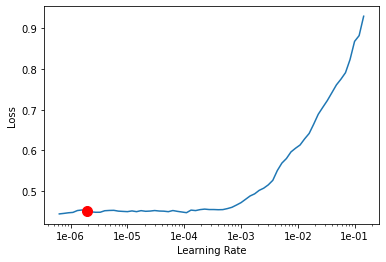

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

9.120108393559096e-07


In [ ]:
lr=1e-04
learn.fit_one_cycle(6,slice(lr,lr/20,lr/200))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.449399,0.448244,0.032967,0.967033,02:49
1,0.444511,0.459489,0.041209,0.958791,02:50
2,0.447839,0.447783,0.030220,0.969780,02:49
3,0.436468,0.445183,0.035714,0.964286,02:50
4,0.431473,0.447918,0.035714,0.964286,02:49
5,0.427002,0.445835,0.035714,0.964286,02:49


In [ ]:
learn.save('stage-4-rn51') 

In [ ]:
learn.load('stage-4-rn51') 

Learner(data=ImageDataBunch;

Train: LabelList (1457 items)
x: ImageList
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
y: CategoryList
3,1,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Valid: LabelList (364 items)
x: ImageList
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
y: CategoryList
2,0,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_r

In [ ]:
learn.freeze()

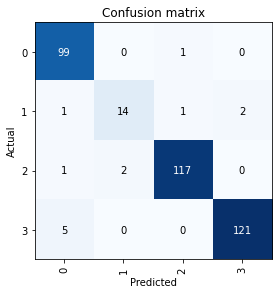

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')

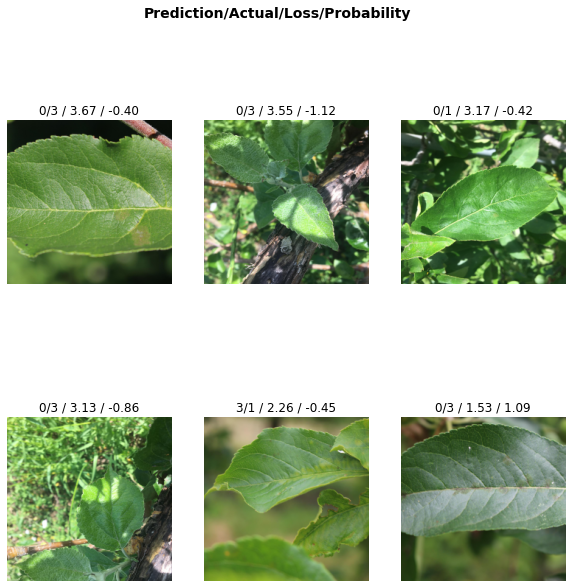

In [ ]:
interp.plot_top_losses(6, figsize=(10,10))

In [ ]:
Submission_TTA(learn,'submit13.csv')

In [ ]:
data=get_data(512,16)

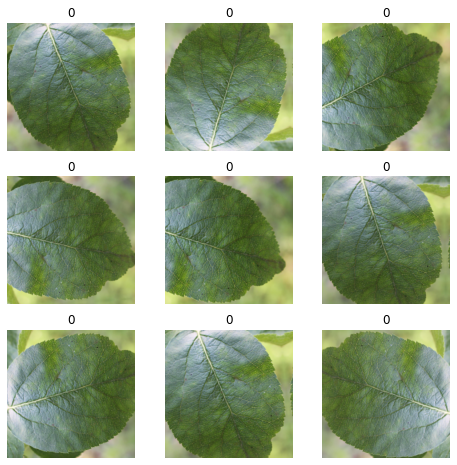

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

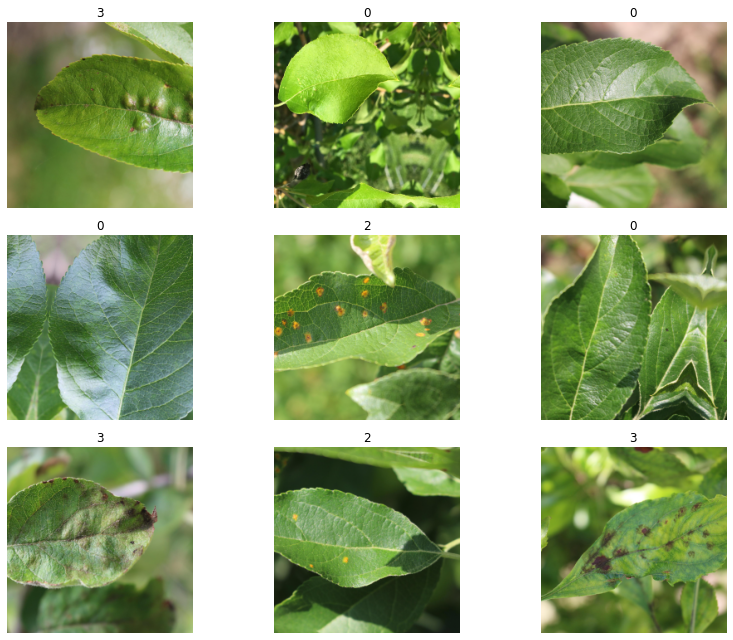

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.58E-06
Min loss divided by 10: 9.12E-04


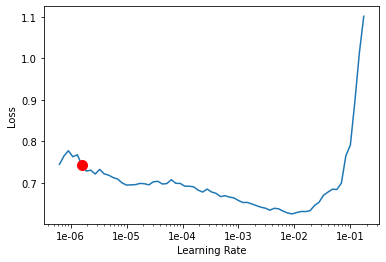

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.5848931924611132e-06


In [ ]:
lr=3e-03
learn.fit_one_cycle(8,slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.611433,0.513793,0.057692,0.942308,06:03
1,0.570292,0.530794,0.063187,0.936813,05:57
2,0.566253,0.527684,0.043956,0.956044,06:00
3,0.535466,0.474252,0.046703,0.953297,05:56
4,0.519624,0.458201,0.052198,0.947802,05:57
5,0.507842,0.450684,0.035714,0.964286,05:58
6,0.480228,0.444155,0.038462,0.961538,05:57
7,0.465491,0.442526,0.035714,0.964286,05:58


In [ ]:
learn.save('stage-5-rn51')

In [ ]:
learn.load('stage-5-rn51')

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.91E-06
Min loss divided by 10: 6.31E-08


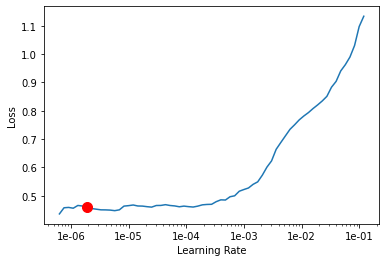

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.9054607179632473e-06


In [ ]:
lr=1e-05
learn.fit_one_cycle(6,slice(lr,lr/20,lr/200))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.455563,0.447136,0.041209,0.958791,06:31
1,0.460674,0.441917,0.041209,0.958791,06:31
2,0.462635,0.439319,0.038462,0.961538,06:28
3,0.461827,0.435803,0.030220,0.969780,06:31
4,0.446502,0.440463,0.041209,0.958791,06:29
5,0.447940,0.450478,0.041209,0.958791,06:21


In [ ]:
learn.save('stage-6-rn51')

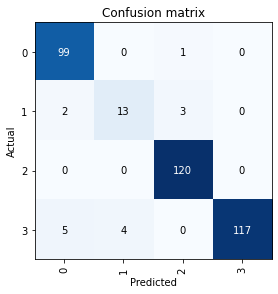

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')

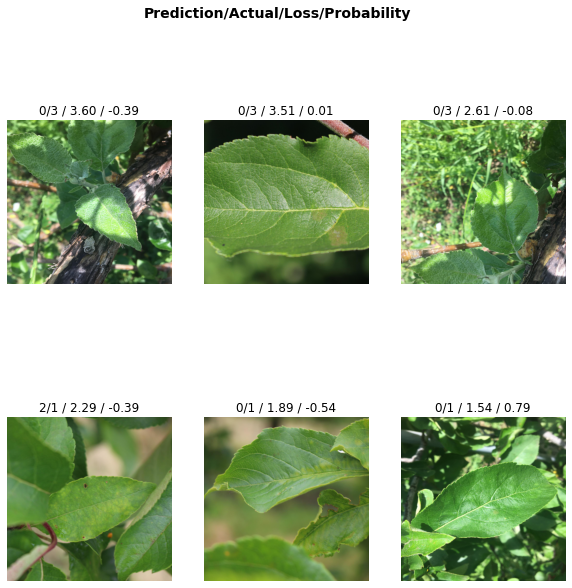

In [ ]:
interp.plot_top_losses(6, figsize=(10,10))

In [ ]:
Submission_TTA(learn,'submit14.csv')

In [ ]:
learn = learn.to_fp16()



# **EFFICIENTNET**

In [ ]:
from fastai.torch_core import flatten_model
from fastai.layers import CrossEntropyFlat


def arch_summary(arch):
    model = arch(False)
    tot = 0
    for i, l in enumerate(model.children()):
        n_layers = len(flatten_model(l))
        tot += n_layers
        print(f'({i}) {l.__class__.__name__:<12}: {n_layers:<4}layers (total: {tot})')


def get_groups(model, layer_groups):
    group_indices = [len(g) for g in layer_groups]
    curr_i = 0
    group = []
    for layer in model:
        group_indices[curr_i] -= len(flatten_model(layer))
        group.append(layer.__class__.__name__)
        if group_indices[curr_i] == 0:
            curr_i += 1
            print(f'Group {curr_i}:', group)   
            group = []

In [ ]:
!pip install --upgrade efficientnet-pytorch

  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.6.3-cp36-none-any.whl size=12422 sha256=7e203265a872141e954c7366064f735cffc2e686df55a3c1019abe610e224e0c
  Stored in directory: /root/.cache/pip/wheels/42/1e/a9/2a578ba9ad04e776e80bf0f70d8a7f4c29ec0718b92d8f6ccd
Successfully built efficientnet-pytorch


In [ ]:
from efficientnet_pytorch import EfficientNet
# model = EfficientNet.from_pretrained('efficientnet-b4', num_classes=4)

In [ ]:
m = EfficientNet.from_pretrained('efficientnet-b7')

Loaded pretrained weights for efficientnet-b7


In [ ]:
#  "pretrained" is hardcoded to adapt to the PyTorch model function
def efficient_net_b7(pretrained=True):
    model = EfficientNet.from_pretrained('efficientnet-b7')
    return nn.Sequential(model)

In [ ]:
arch_summary(lambda _:m)

(0) Conv2dStaticSamePadding: 2   layers (total: 2)
(1) BatchNorm2d : 1   layers (total: 3)
(2) ModuleList  : 868 layers (total: 871)
(3) Conv2dStaticSamePadding: 2   layers (total: 873)
(4) BatchNorm2d : 1   layers (total: 874)
(5) AdaptiveAvgPool2d: 1   layers (total: 875)
(6) Dropout     : 1   layers (total: 876)
(7) Linear      : 1   layers (total: 877)
(8) MemoryEfficientSwish: 1   layers (total: 878)


In [ ]:
arch_summary(lambda _: list(m.children())[1])

In [ ]:
model_meta[efficient_net_b7] =  { 'cut': noop, 
                               'split': lambda m: (list(m[0][0].children())[2][7], m[1]) }

In [ ]:
data=get_data(224,16)

In [ ]:
# output_size = list(efficient_net_b0()[0].children())[-1].out_features

In [ ]:
custom_head = nn.Linear(1000, data.c)

In [ ]:
# learn = Learner(data, model,metrics=[error_rate, accuracy])

In [ ]:
learn = cnn_learner(data,efficient_net_b7, custom_head = custom_head,metrics=[error_rate, accuracy]).mixup().to_fp16()

Loaded pretrained weights for efficientnet-b7


In [ ]:
learn.loss_func=LabelSmoothingCrossEntropy()

In [ ]:
get_groups(nn.Sequential(*list(learn.model[0][0].children())[:2], 
                         *list(learn.model[0][0].children())[2],
                         *list(learn.model[0][0].children())[3:],
                         learn.model[1]), 
           learn.layer_groups)

Group 1: ['Conv2dStaticSamePadding', 'BatchNorm2d', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock']
Group 2: ['MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'Conv2dStaticSamePadding', 'BatchNorm2d', 'AdaptiveAvgPool2d', 'Dropout', 'Linear', 'MemoryEfficientSwish']
Group

In [ ]:
learn.summary

<bound method model_summary of Learner(data=ImageDataBunch;

Train: LabelList (1457 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
3,1,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Valid: LabelList (364 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
2,0,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Test: None, model=Sequential(
  (0): Sequential(
    (0): EfficientNet(
      (_conv_stem): Conv2dStaticSamePadding(
        3, 64, kernel_size=(3, 3), stride=(2, 2), bias=False
        (static_padding): ZeroPad2d(padding=(0, 1, 0, 1), value=0.0)
      )
      (_bn0): BatchNorm2d(64, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_blocks): ModuleList(
        (0): MBConvBlock(
          (_depthwise_conv): Conv2dStaticSamePadding(
            64, 64, kernel_si

In [ ]:
# learn.summary

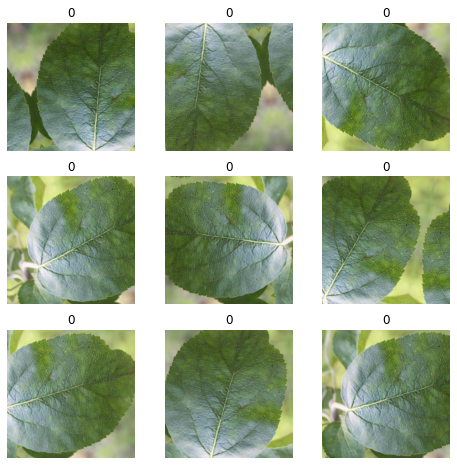

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

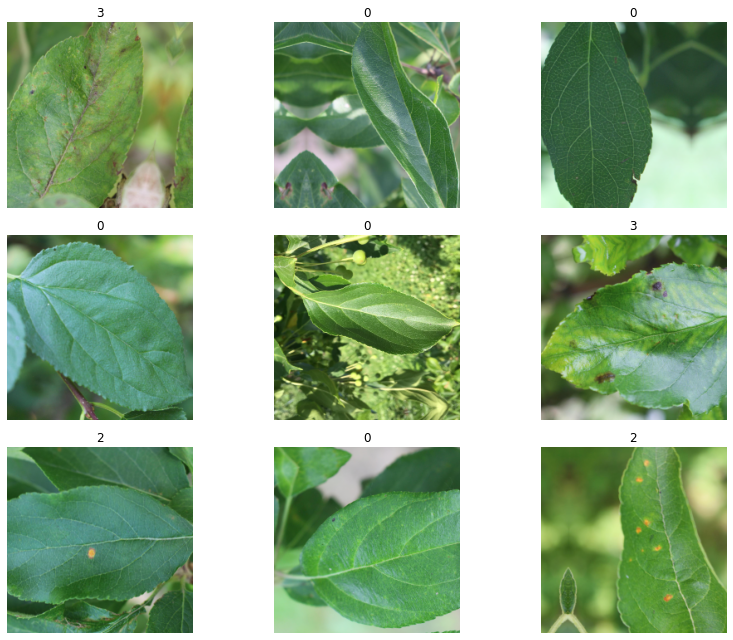

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.freeze()

In [ ]:

learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 6.31E-07
Min loss divided by 10: 6.92E-03


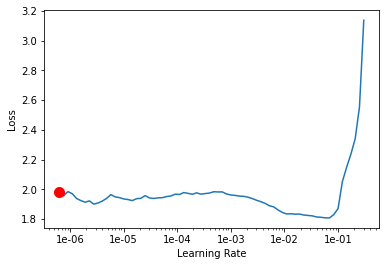

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

6.309573444801933e-07


In [ ]:
lr=1e-02
learn.fit_one_cycle(10, slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.517633,1.292076,0.532967,0.467033,02:39
1,1.395076,1.117164,0.365385,0.634615,02:36
2,1.719550,1.157075,0.326923,0.673077,02:33
3,1.622293,0.912986,0.214286,0.785714,02:31
4,1.480522,0.891470,0.222527,0.777473,02:33
5,1.248175,0.775048,0.197802,0.802198,02:34
6,1.122750,0.742366,0.175824,0.824176,02:34
7,1.006292,0.701439,0.164835,0.835165,02:32
8,0.966834,0.681488,0.142857,0.857143,02:34
9,0.948184,0.682405,0.151099,0.848901,02:33


In [ ]:
learn.save('stage-1-effnet')                   

In [ ]:
# learn.load('stage-1-effnet')                   

In [ ]:
 len(learn.layer_groups)

3

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 6.31E-07
Min loss divided by 10: 1.58E-07


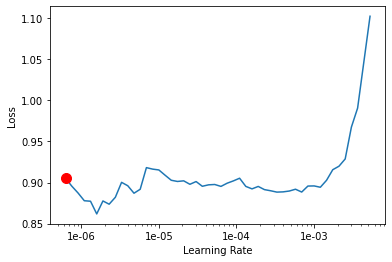

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

6.309573444801933e-07


In [ ]:
lr=1e-04
learn.fit_one_cycle(8,slice(lr,lr/20))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.920708,0.669947,0.142857,0.857143,02:48
1,0.881761,0.622614,0.112637,0.887363,02:46
2,0.876165,0.593234,0.093407,0.906593,02:46
3,0.866770,0.602532,0.104396,0.895604,02:47
4,0.829647,0.565943,0.074176,0.925824,02:46
5,0.815717,0.558909,0.082418,0.917582,02:44
6,0.805303,0.558947,0.076923,0.923077,02:44
7,0.802309,0.560914,0.079670,0.920330,02:46


In [ ]:
learn.save('stage-2-efficnet')                 

In [ ]:
learn.load('stage-2-efficnet')                 

Learner(data=ImageDataBunch;

Train: LabelList (1457 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
3,1,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Valid: LabelList (364 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
2,0,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Test: None, model=Sequential(
  (0): Sequential(
    (0): EfficientNet(
      (_conv_stem): Conv2dStaticSamePadding(
        3, 64, kernel_size=(3, 3), stride=(2, 2), bias=False
        (static_padding): ZeroPad2d(padding=(0, 1, 0, 1), value=0.0)
      )
      (_bn0): BatchNorm2d(64, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_blocks): ModuleList(
        (0): MBConvBlock(
          (_depthwise_conv): Conv2dStaticSamePadding(
            64, 64, kernel_size=(3, 3), stride=[1, 1], group

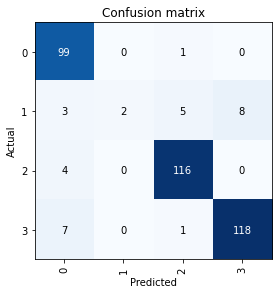

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')

In [ ]:
# Submission_TTA(learn,'submit10.csv')

In [ ]:
learn.freeze()

In [ ]:
data=get_data(224,32)   

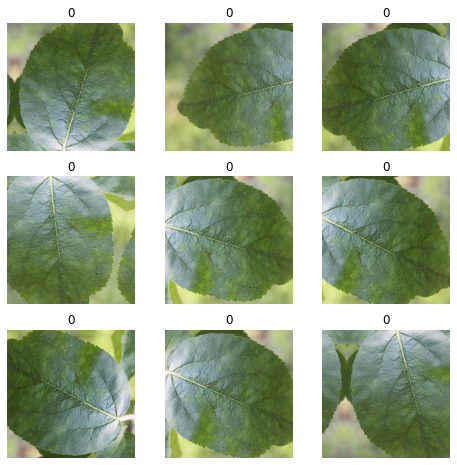

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

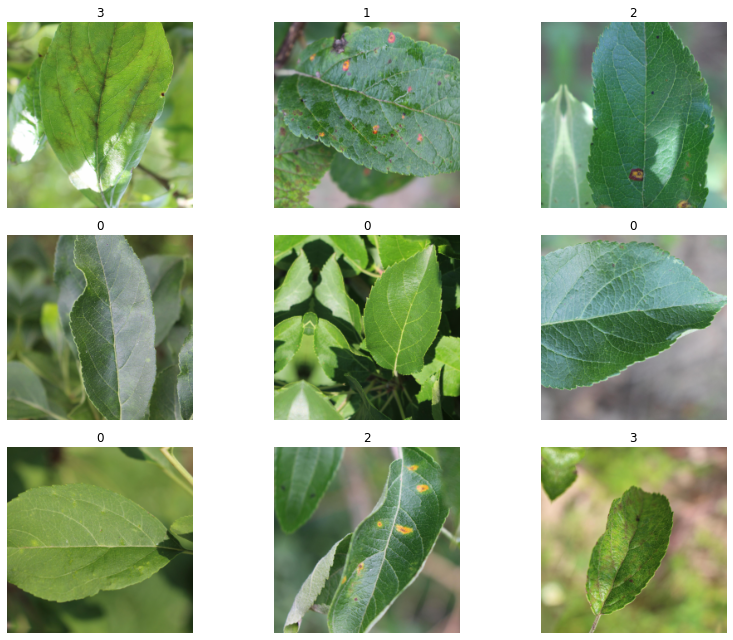

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.freeze()

In [ ]:

learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 9.12E-07
Min loss divided by 10: 3.98E-03


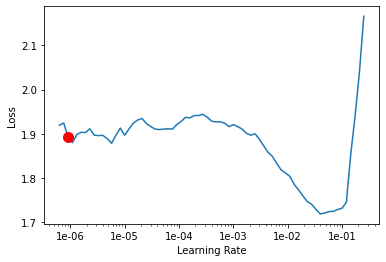

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

9.120108393559096e-07


In [ ]:
lr=1e-02
learn.fit_one_cycle(10, slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.645082,1.413947,0.626374,0.373626,03:08
1,1.409365,1.366510,0.464286,0.535714,03:04
2,1.461681,1.120175,0.326923,0.673077,03:05
3,1.468368,1.047089,0.321429,0.678571,03:06
4,1.389379,0.962535,0.241758,0.758242,03:02
5,1.271830,0.829247,0.228022,0.771978,03:03
6,1.153350,0.771661,0.192308,0.807692,03:03
7,1.074936,0.725616,0.175824,0.824176,03:02
8,1.030377,0.704424,0.170330,0.829670,03:02
9,0.986911,0.709634,0.175824,0.824176,03:02


In [ ]:
learn.save('stage-3-effnet')                   

In [ ]:
# learn.load('stage-3-effnet')                   

In [ ]:
 len(learn.layer_groups)

3

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 9.12E-07
Min loss divided by 10: 2.09E-04


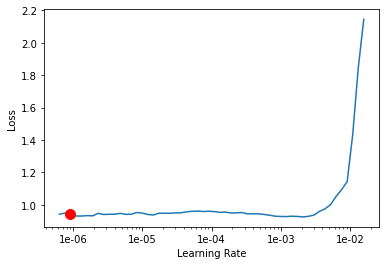

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

9.120108393559096e-07


In [ ]:
lr=1e-03
learn.fit_one_cycle(7,slice(lr,lr/20,lr/200))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.946902,0.648291,0.120879,0.879121,03:18
1,0.864916,0.626198,0.112637,0.887363,03:21
2,0.829366,0.569436,0.096154,0.903846,03:21
3,0.787007,0.517674,0.068681,0.931319,03:19
4,0.751706,0.497446,0.057692,0.942308,03:20
5,0.725368,0.485571,0.052198,0.947802,03:19
6,0.700633,0.483813,0.049451,0.950549,03:20


In [ ]:
learn.save('stage-4-efficient')                 

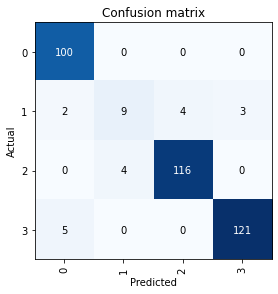

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')

In [ ]:
interp.plot_top_losses(6, figsize=(10,10))

NameError: ignored

In [ ]:
Submission_TTA(learn,'submit10.csv')

RuntimeError: ignored

In [ ]:
learn.load('stage-4-efficient')                 

Learner(data=ImageDataBunch;

Train: LabelList (1457 items)
x: ImageList
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
y: CategoryList
3,1,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Valid: LabelList (364 items)
x: ImageList
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
y: CategoryList
2,0,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Test: None, model=Sequential(
  (0): Sequential(
    (0): EfficientNet(
      (_conv_stem): Conv2dStaticSamePadding(
        3, 64, kernel_size=(3, 3), stride=(2, 2), bias=False
        (static_padding): ZeroPad2d(padding=(0, 1, 0, 1), value=0.0)
      )
      (_bn0): BatchNorm2d(64, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_blocks): ModuleList(
        (0): MBConvBlock(
          (_depthwise_conv): Conv2dStaticSamePadding(
            64, 64, kernel_size=(3, 3), stride=[1, 1], group

In [ ]:
learn.freeze()

In [ ]:
data=get_data(512,8)   

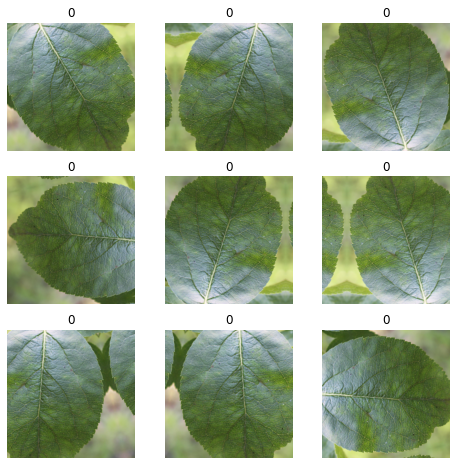

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

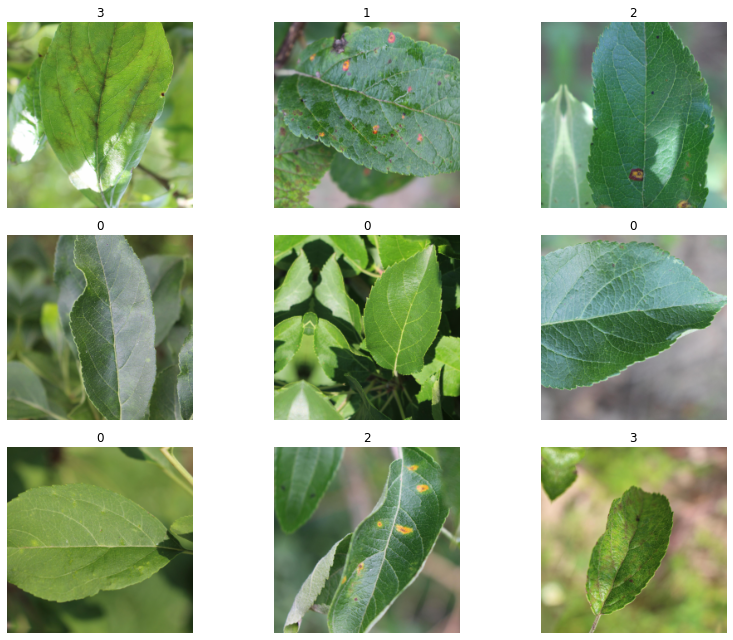

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.freeze()

AssertionError: ignored

In [ ]:
torch.cuda.empty_cache()

In [ ]:
learn.destroy() 

this Learner object self-destroyed - it still exists, but no longer usable


In [ ]:
gc.collect()
torch.cuda.empty_cache()

In [ ]:

learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


RuntimeError: ignored

Min numerical gradient: 7.59E-07
Min loss divided by 10: 1.58E-07


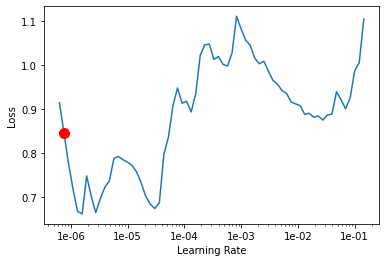

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

7.585775750291837e-07


In [ ]:
lr=mingradlr
learn.fit_one_cycle(10, slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.969644,0.330251,0.107143,0.892857,05:36
1,0.722937,0.347489,0.123626,0.876374,05:31
2,0.798746,0.339970,0.115385,0.884615,05:25
3,0.680760,0.334360,0.115385,0.884615,05:24
4,0.727143,0.340396,0.115385,0.884615,05:24
5,0.882318,0.335845,0.115385,0.884615,05:23
6,0.835749,0.334134,0.112637,0.887363,05:23
7,0.908123,0.343168,0.120879,0.879121,05:24
8,0.772535,0.321562,0.115385,0.884615,05:24
9,0.819651,0.343101,0.112637,0.887363,05:25


In [ ]:
learn.save('stage-5-effnet')                   

In [ ]:
# learn.load('stage-5-effnet')                   

In [ ]:
 len(learn.layer_groups)

3

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.10E-06
Min loss divided by 10: 2.51E-06


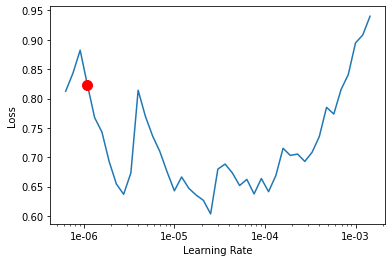

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.096478196143185e-06


In [ ]:
lr=mingradlr
learn.fit_one_cycle(5,slice(lr,lr/20))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.744497,0.350219,0.126374,0.873626,06:53
1,0.918460,0.325371,0.115385,0.884615,06:53
2,0.620104,0.315160,0.109890,0.890110,06:53
3,0.838748,0.308284,0.109890,0.890110,06:53
4,0.667250,0.298561,0.101648,0.898352,06:53


In [ ]:
learn.save('stage-6-efficient')                 

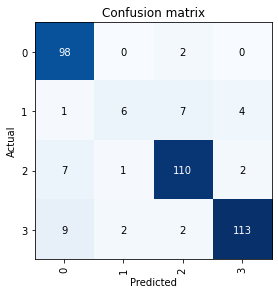

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')

#EFFICIENT B-6

In [ ]:
from fastai.torch_core import flatten_model
from fastai.layers import CrossEntropyFlat


def arch_summary(arch):
    model = arch(False)
    tot = 0
    for i, l in enumerate(model.children()):
        n_layers = len(flatten_model(l))
        tot += n_layers
        print(f'({i}) {l.__class__.__name__:<12}: {n_layers:<4}layers (total: {tot})')


def get_groups(model, layer_groups):
    group_indices = [len(g) for g in layer_groups]
    curr_i = 0
    group = []
    for layer in model:
        group_indices[curr_i] -= len(flatten_model(layer))
        group.append(layer.__class__.__name__)
        if group_indices[curr_i] == 0:
            curr_i += 1
            print(f'Group {curr_i}:', group)   
            group = []

In [ ]:
!pip install --upgrade efficientnet-pytorch

  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.6.3-cp36-none-any.whl size=12422 sha256=9d4f5915c3bf5a4b35b0d695e450650e2216076a999b577eda060cfdc8f7395d
  Stored in directory: /root/.cache/pip/wheels/42/1e/a9/2a578ba9ad04e776e80bf0f70d8a7f4c29ec0718b92d8f6ccd
Successfully built efficientnet-pytorch


In [ ]:
from efficientnet_pytorch import EfficientNet
# model = EfficientNet.from_pretrained('efficientnet-b4', num_classes=4)

In [ ]:
m = EfficientNet.from_pretrained('efficientnet-b6')

Loaded pretrained weights for efficientnet-b7


In [ ]:
#  "pretrained" is hardcoded to adapt to the PyTorch model function
def efficient_net_b7(pretrained=True):
    model = EfficientNet.from_pretrained('efficientnet-b6')
    return nn.Sequential(model)

In [ ]:
arch_summary(lambda _:m)

(0) Conv2dStaticSamePadding: 2   layers (total: 2)
(1) BatchNorm2d : 1   layers (total: 3)
(2) ModuleList  : 868 layers (total: 871)
(3) Conv2dStaticSamePadding: 2   layers (total: 873)
(4) BatchNorm2d : 1   layers (total: 874)
(5) AdaptiveAvgPool2d: 1   layers (total: 875)
(6) Dropout     : 1   layers (total: 876)
(7) Linear      : 1   layers (total: 877)
(8) MemoryEfficientSwish: 1   layers (total: 878)


In [ ]:
arch_summary(lambda _: list(m.children())[1])

In [ ]:
model_meta[efficient_net_b7] =  { 'cut': noop, 
                               'split': lambda m: (list(m[0][0].children())[2][7], m[1]) }

In [ ]:
data=get_data(224,32)

In [ ]:
# output_size = list(efficient_net_b0()[0].children())[-1].out_features

In [ ]:
custom_head = nn.Linear(1000, data.c)

In [ ]:
# learn = Learner(data, model,metrics=[error_rate, accuracy])

In [ ]:
learn = cnn_learner(data,efficient_net_b6, custom_head = custom_head,metrics=[error_rate, accuracy]).mixup().to_fp16()

Loaded pretrained weights for efficientnet-b7


In [ ]:
learn.loss_func=LabelSmoothingCrossEntropy()

In [ ]:
get_groups(nn.Sequential(*list(learn.model[0][0].children())[:2], 
                         *list(learn.model[0][0].children())[2],
                         *list(learn.model[0][0].children())[3:],
                         learn.model[1]), 
           learn.layer_groups)

Group 1: ['Conv2dStaticSamePadding', 'BatchNorm2d', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock']
Group 2: ['MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'MBConvBlock', 'Conv2dStaticSamePadding', 'BatchNorm2d', 'AdaptiveAvgPool2d', 'Dropout', 'Linear', 'MemoryEfficientSwish']
Group

In [ ]:
learn.summary

<bound method model_summary of Learner(data=ImageDataBunch;

Train: LabelList (1457 items)
x: ImageList
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
y: CategoryList
3,1,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Valid: LabelList (364 items)
x: ImageList
Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512),Image (3, 512, 512)
y: CategoryList
2,0,0,2,0
Path: /content/plant-pathology-2020-fgvc7/data;

Test: None, model=Sequential(
  (0): Sequential(
    (0): EfficientNet(
      (_conv_stem): Conv2dStaticSamePadding(
        3, 64, kernel_size=(3, 3), stride=(2, 2), bias=False
        (static_padding): ZeroPad2d(padding=(0, 1, 0, 1), value=0.0)
      )
      (_bn0): BatchNorm2d(64, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_blocks): ModuleList(
        (0): MBConvBlock(
          (_depthwise_conv): Conv2dStaticSamePadding(
            64, 64, kernel_si

In [ ]:
# learn.summary

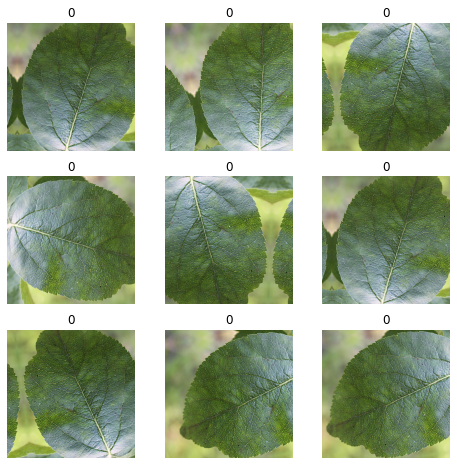

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

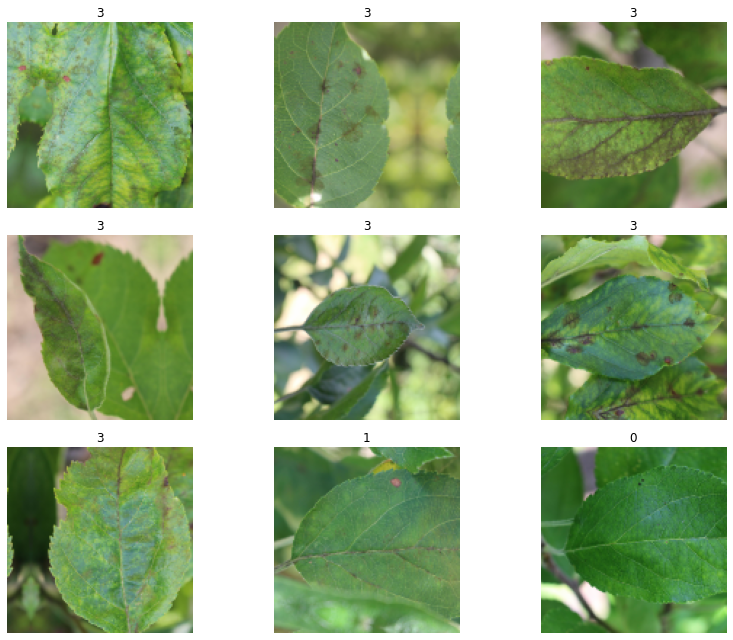

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.freeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 6.31E-07
Min loss divided by 10: 3.98E-03


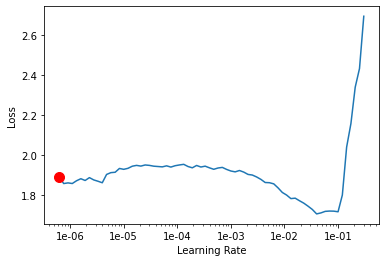

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

6.309573444801933e-07


In [ ]:
lr=1e-02
learn.fit_one_cycle(10, slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.595542,1.354374,0.574176,0.425824,02:33
1,1.309574,1.046062,0.447802,0.552198,02:29
2,1.345888,0.912031,0.329670,0.670330,02:24
3,1.354262,0.828788,0.280220,0.719780,02:21
4,1.272076,0.697854,0.219780,0.780220,02:20
5,1.186657,0.558334,0.195055,0.804945,02:19
6,1.050775,0.522988,0.173077,0.826923,02:19
7,0.965983,0.507399,0.159341,0.840659,02:20
8,0.905467,0.484026,0.151099,0.848901,02:19
9,0.849851,0.487875,0.151099,0.848901,02:20


In [ ]:
learn.save('stage-1-effnet')                   

In [ ]:
# learn.load('stage-1-effnet')                   

In [ ]:
 len(learn.layer_groups)

3

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 6.31E-07
Min loss divided by 10: 7.59E-08


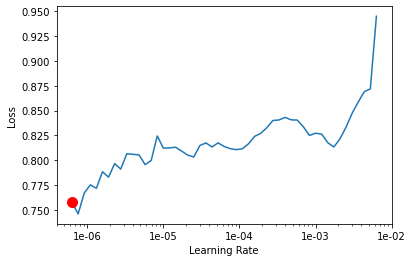

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

6.309573444801933e-07


In [ ]:
lr=mingradlr
learn.fit_one_cycle(6,slice(lr,lr/20))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.843410,0.492172,0.151099,0.848901,02:28
1,0.841680,0.494202,0.153846,0.846154,02:25
2,0.833622,0.496340,0.153846,0.846154,02:25
3,0.825565,0.497406,0.156593,0.843407,02:24
4,0.836484,0.499389,0.156593,0.843407,02:23
5,0.818108,0.499879,0.156593,0.843407,02:24


In [ ]:
learn.save('stage-2-efficnet')                 

In [ ]:
learn.load('stage-2-efficnet')                 

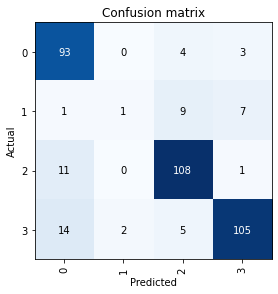

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')

In [ ]:
# Submission_TTA(learn,'submit10.csv')

In [ ]:
learn.freeze()

In [ ]:
data=get_data(224,32)   

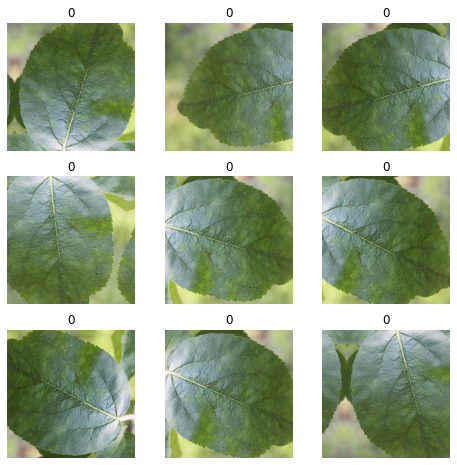

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

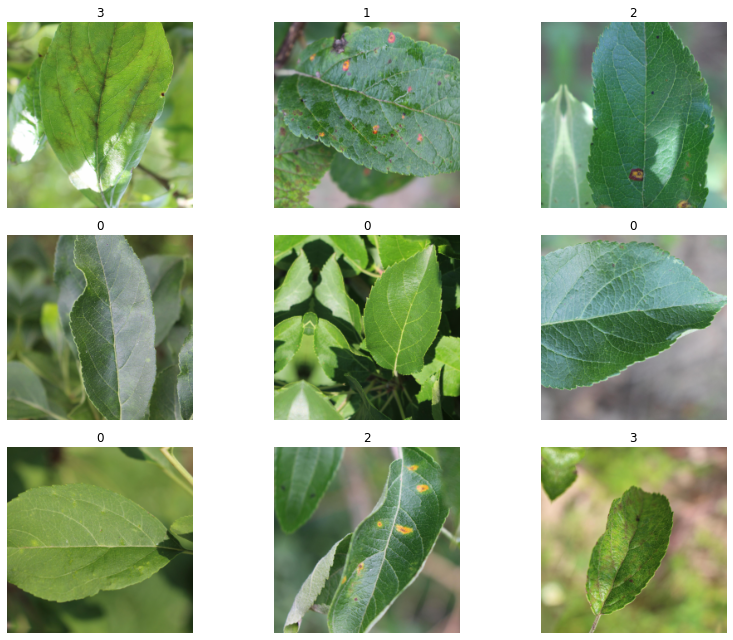

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.freeze()

In [ ]:

learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


Min numerical gradient: 1.10E-06
Min loss divided by 10: 3.98E-03


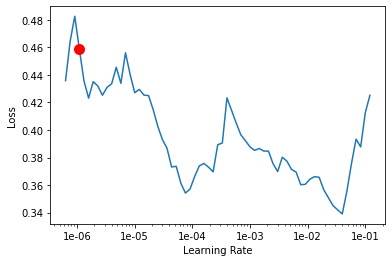

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

1.096478196143185e-06


In [ ]:
lr=1e-02
learn.fit_one_cycle(10, slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.340711,0.269825,0.079670,0.920330,02:23
1,0.335943,0.284046,0.076923,0.923077,02:22
2,0.394834,0.391366,0.112637,0.887363,02:20
3,0.396980,0.415264,0.079670,0.920330,02:21
4,0.388827,0.354396,0.068681,0.931319,02:21
5,0.352380,0.286524,0.054945,0.945055,02:24
6,0.340976,0.282509,0.052198,0.947802,02:21
7,0.347932,0.263177,0.054945,0.945055,02:21
8,0.292185,0.231371,0.052198,0.947802,02:21
9,0.300116,0.231556,0.052198,0.947802,02:21


In [ ]:
learn.save('stage-3-effnet')                   

In [ ]:
learn.load('stage-3-effnet')                   

In [ ]:
 len(learn.layer_groups)

3

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

epoch,train_loss,valid_loss,error_rate,accuracy,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Failed to compute the gradients, there might not be enough points.


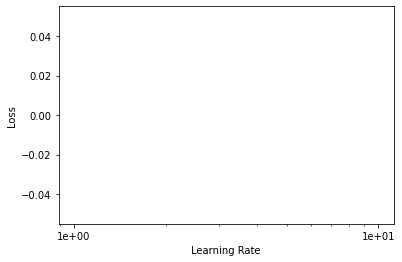

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

In [ ]:
lr=1e-04
learn.fit_one_cycle(5,slice(lr,lr/20))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.235778,0.252936,0.052198,0.947802,02:40
1,0.257980,0.217717,0.057692,0.942308,02:38
2,0.216194,0.188877,0.052198,0.947802,02:36
3,0.179930,0.178764,0.046703,0.953297,02:36
4,0.187596,0.180839,0.052198,0.947802,02:35


In [ ]:
learn.save('stage-4-efficient')                 

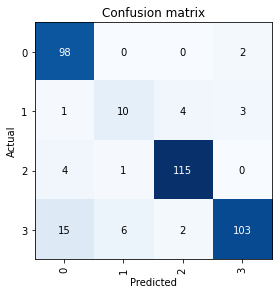

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')

# SE RESNET 101

In [ ]:
!pip install pretrainedmodels
import pretrainedmodels

In [ ]:
print(pretrainedmodels.model_names)

['fbresnet152', 'bninception', 'resnext101_32x4d', 'resnext101_64x4d', 'inceptionv4', 'inceptionresnetv2', 'alexnet', 'densenet121', 'densenet169', 'densenet201', 'densenet161', 'resnet18', 'resnet34', 'resnet50', 'resnet101', 'resnet152', 'inceptionv3', 'squeezenet1_0', 'squeezenet1_1', 'vgg11', 'vgg11_bn', 'vgg13', 'vgg13_bn', 'vgg16', 'vgg16_bn', 'vgg19_bn', 'vgg19', 'nasnetamobile', 'nasnetalarge', 'dpn68', 'dpn68b', 'dpn92', 'dpn98', 'dpn131', 'dpn107', 'xception', 'senet154', 'se_resnet50', 'se_resnet101', 'se_resnet152', 'se_resnext50_32x4d', 'se_resnext101_32x4d', 'cafferesnet101', 'pnasnet5large', 'polynet']


In [ ]:
model_name = 'se_resnet101' 
model = pretrainedmodels.__dict__[model_name](num_classes=1000, pretrained='imagenet')

Downloading: "http://data.lip6.fr/cadene/pretrainedmodels/se_resnet101-7e38fcc6.pth" to /root/.cache/torch/checkpoints/se_resnet101-7e38fcc6.pth


In [ ]:
def se_resnet101(pretrained=True):
    pretrained = 'imagenet' if pretrained else None
    model = pretrainedmodels.se_resnet101(pretrained=pretrained)
    return model

In [ ]:
data=get_data(224)

In [ ]:
learn = cnn_learner(data,se_resnet101, pretrained=False,
                    cut=-2, split_on=lambda m: (m[0][3], m[1]),metrics=[error_rate, accuracy])

In [ ]:
get_groups(nn.Sequential(*learn.model[0], *learn.model[1]), learn.layer_groups)

In [ ]:
# learn = Learner(data, model,metrics=[error_rate, accuracy])

In [ ]:
learn.summary

In [ ]:
_se_resnet_meta = {'cut': -2, 'split': lambda m: (m[0][3], m[1]) }

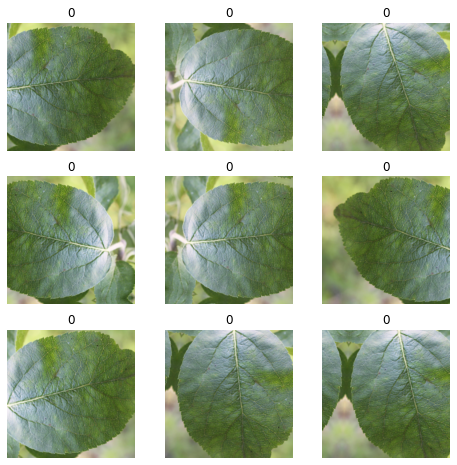

In [ ]:
def _plot(i,j,ax):
    x,y = data.train_ds[5]
    x.show(ax, y=y)

    
plot_multi(_plot, 3, 3, figsize=(8,8))

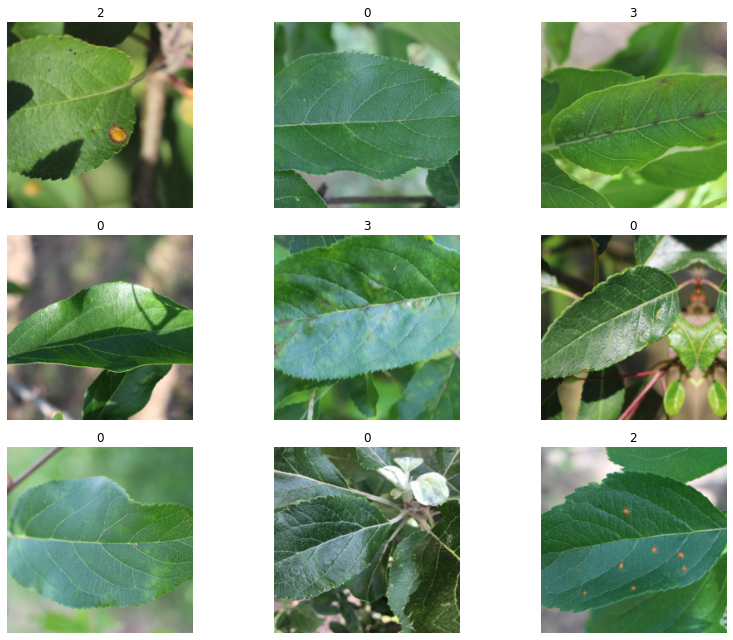

In [ ]:
data.show_batch(rows=3, figsize=(12,9))

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 6.31E-07
Min loss divided by 10: 1.20E-02


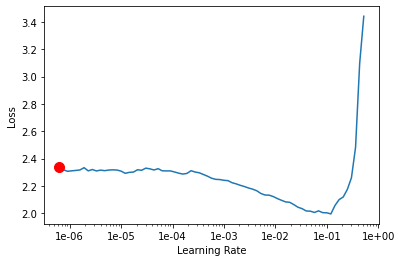

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

0.0020892961308540407


In [ ]:
lr=1e-02
learn.fit_one_cycle(10, slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,2.015934,2.974551,0.950549,0.049451,02:20
1,1.733012,2.244639,0.642857,0.357143,02:14
2,1.636338,2.610406,0.596154,0.403846,02:14
3,1.571428,2.043582,0.480769,0.519231,02:13
4,1.442689,1.436230,0.409341,0.590659,02:13
5,1.401015,1.902538,0.469780,0.530220,02:14
6,1.379379,2.398542,0.467033,0.532967,02:14
7,1.315508,0.923021,0.373626,0.626374,02:14
8,1.222601,1.031102,0.359890,0.640110,02:16
9,1.150313,0.892228,0.337912,0.662088,02:18


In [ ]:
learn.save('stage-1-seresnet')                   

In [ ]:
# learn.load('stage-1-effnet')                   

In [ ]:
 len(learn.layer_groups)

3

In [ ]:
learn.unfreeze()

In [ ]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 6.31E-07
Min loss divided by 10: 8.32E-07


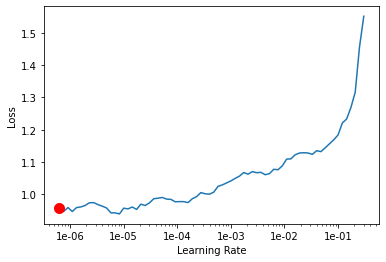

In [ ]:
learn.recorder.plot(suggestion=True)

In [ ]:
mingradlr = learn.recorder.min_grad_lr
print(mingradlr)

6.309573444801933e-07


In [ ]:
lr=mingradlr
learn.fit_one_cycle(5,slice(lr))

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.000031,0.896214,0.340659,0.659341,02:16
1,1.024612,0.909721,0.340659,0.659341,02:16
2,1.034196,0.987636,0.329670,0.670330,02:15
3,1.038300,0.950114,0.337912,0.662088,02:16
4,1.046899,0.925265,0.340659,0.659341,02:15


In [ ]:
learn.save('stage-8-rn34')                 

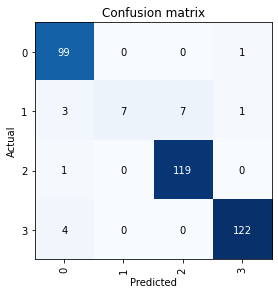

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')